# Week 7
## Overview

This week's curriculum focuses in figuring out (and visualizing) what's special about a certain text (or collection of texts). We'll also learn about community detection in networks (that's how we'll get our groups of text)

* Tricks for raw text (NLPP, Chapter 3).
* Community Detection and info-boxes 
* Identifying important words in a document (TF-IDF)

In the first part, we will take a quick tour of NLPP's chapter 3, which is boring, super useful resource. Then we'll talk about how we can use simple statistics & machine learning to get text to show us what it's all about. We will even do a little visualization. 

In the latter parts we will go back to network science, discussing community detection, mixing in some NLP, and trying it all out on our very own dataset.


# Part 1: Processing real text (from out on the inter-webs)

Ok. So Chapter 3 in NLPP is all about working with text from the real world. Getting text from this internet, cleaning it, tokenizing, modifying (e.g. stemming, converting to lower case, etc) to get the text in shape to work with the NLTK tools you've already learned about - and many more. 

In the process we'll learn more about regular expressions, as well as unicode; something we've already been struggling with a little bit will now be explained in more detail. 

<div class="alert alert-block alert-info">
One of the things that the LLMs have changed is how we don't have to suffer over regular expressions as much as in the old days. As I talk about in the video, regular expressions used to be a big, painful part of working with text. Nowadays, we can simply ask an LLM to help construct them ... and it tends to work really well. And regular expressions are not really important to know about - you need to know they exist so you can used them, but the details are not worth remembering. So this is one area where you can use LLMs as much as you like without a guilty conscience. (But remember to check and test the results thoroughly! The LLMs might still make mistakes.)
</div>

> 
> **Video lecture**: Short overview of chapter 3 + a few words about kinds of language processing that we don't address in this class. 
> 

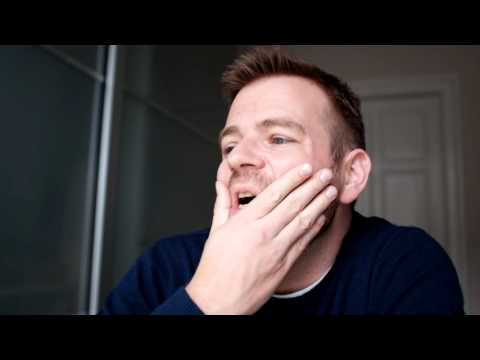

In [21]:
from IPython.display import YouTubeVideo
YouTubeVideo("Rwakh-HXPJk",width=800, height=450)

> *Reading*: NLPP Chapter 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.9, and 3.10\. It's not important that you go in depth with everything here - the key think is that you *know that Chapter 3 of this book exists*, and that it's a great place to return to if you're ever in need of an explanation of regular expressions, unicode, or other topics that you forget as soon as you stop using them (and don't worry, I forget about those things too).
> 

# Part 2: Community detection

Let's begin by watching a lecture to learn about communities. If you want all the details, I recommend you take a look at _Chapter 9_ in the _Network Science_ book ... but the video lecture below should be enough to get you started. 

**Note**: For this and the next exercise, work on the _undirected_ version of the network.

> **_Video Lecture_**: Communities in networks. 

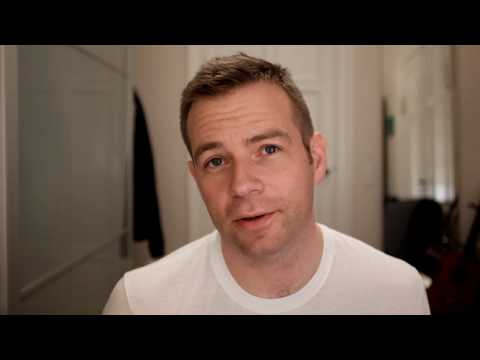

In [22]:
YouTubeVideo("FSRoqXw28RI",width=800, height=450)

# direct youtube link: https://www.youtube.com/watch?v=FSRoqXw28RI

# Notes from the video
### Modularity: 
A comminuty is connected to other communities by edges with high edge betweeness. A good division of a network into communities is one in which there are fewer than expected edges between communities. Modularity indicates how good a division of a network into community is.

### K-cliques:
A cliques is a fully connected subgraph. A k-clique-community is a union of all k-cliques theat can be reached from each other through a series of adjacent k-cliques (adjacency means sharing k-1 nodes). Increasing the number k we find denser and denser communities.

### Link Communities:
Each node should be able to be a member of different communities. Hierarchical structure and communities were thought to be two sides of the same story but this is not completely true. To solve this we can categorize links and cluster similar links (links do not overlap). They defined a similarity between links (see video for formula) and then create a dendogram with a partition density graph that tells you where to cut the network.


Before we get started on *network* communities, we'll grab some information on a different kind of communities based on information from Wikipedia. Specifically, the ``infoboxes``. An infobox is the little box usually displayed on the right when you open an artist's page. 

For example if you open the page for [The Rolling Stones](https://en.wikipedia.org/wiki/The_Rolling_Stones), you'll see that it contains info about their place of ***origin***, the ***genre***s of music they've been associated with (in the case of the Stones it's `rock`, `pop` and `blues`), their ***year's active***, the record ***labels*** they've signed with over time, etc. All really interesting information if we want to understand the network of artists.

So let's start with an exercise designed to give you a sense of how good the LLMs are at the whole text-parsing thing.

*Exercise*: Go nuts with an LLM and get all the genres for the nodes in your network
> * Yes, I'm serious. For this one I'd like you to fire up your most powerful thinking model you have access to and get it to write a script to extract genre for all nodes in your network. Some notes to help you
>   * If the node doesn't have an `infobox` (or if a node's infobox doesn't have a `genre` it it), just don't assign that node a genre and ignore it in the downstream analysis
>   * Remember to lowercase all genres, also consider simplifying things by mapping `rock'n'roll`, `rock & roll`, etc to a single genre. 
>   * Remember to test your algorithm well before emplying it, since you're not writing the code yourself, you need to work harder to prove to yourself that it's actually doing what you think it's doing. You should inspect the code to understand what it's actually doing and also test it on the strangest edge-cases you can find. (Can it handle, "The Animals", for example).
>   * The output should be a dictionary mapping artist names to lists of genres (since most artists have multiple genres listed).
> * Report the following stats
>   * The number of nodes for which you could find genres
>   * The average number of genres per node
>   * The total number of distinct genres
>   * A histogram showing artist counts for the top 15 genres

<div class="alert alert-block alert-info">
LLMs all the way for this one. 
</div>

In [ ]:
import networkx as nx
import requests
from bs4 import BeautifulSoup
import re
import time
import matplotlib.pyplot as plt
from collections import Counter
import pickle
import os
import random
import networkx.algorithms.community as nx_comm
import forceatlas2
import backboning_p3nx2.backboning as bb
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
import pandas as pd
from wordcloud import WordCloud
import numpy as np
import seaborn as sns
import math

In [24]:
url = "https://raw.githubusercontent.com/Jacopo00811/socialgraphs2025/refs/heads/main/graphs/rock_performers_network.graphml"

try:
    response = requests.get(url)
    response.raise_for_status()
    G = nx.parse_graphml(response.text)

    print("Successfully loaded the graph from GitHub.")
    print(f"Graph has {G.number_of_nodes()} nodes and {G.number_of_edges()} edges.")
except requests.exceptions.RequestException as e:
    print(f"Failed to download the graph fil    e: {e}")

G_undirected = G.to_undirected()

Successfully loaded the graph from GitHub.
Graph has 487 nodes and 7370 edges.


In [25]:
def get_wikipedia_page(artist_name):
    """Fetch Wikipedia page for an artist."""
    # Format the artist name for URL
    formatted_name = artist_name.replace(" ", "_")
    url = f"https://en.wikipedia.org/wiki/{formatted_name}"
    
    try:
        headers = {'User-Agent': 'Mozilla/5.0 (Jupyter Notebook) Educational project/1.0'}
        response = requests.get(url, headers=headers)
        if response.status_code == 200:
            return response.text
        else:
            # Try with "band" or "musician" appended if not found
            url = f"https://en.wikipedia.org/wiki/{formatted_name}_(band)"
            response = requests.get(url)
            if response.status_code == 200:
                return response.text
            
            url = f"https://en.wikipedia.org/wiki/{formatted_name}_(musician)"
            response = requests.get(url)
            if response.status_code == 200:
                return response.text
            
            return None
    except Exception as e:
        print(f"Error fetching page for {artist_name}: {e}")
        return None

def extract_genres_from_infobox(html):
    """Extract genre information from Wikipedia infobox."""
    if not html:
        return []
    
    soup = BeautifulSoup(html, 'html.parser')
    
    # Find the infobox table
    infobox = soup.find('table', {'class': 'infobox'})
    if not infobox:
        return []
    
    # Look for the genre row in the infobox
    genre_row = None
    for row in infobox.find_all('tr'):
        header = row.find('th')
        if header and ('Genre' in header.get_text() or 'Genres' in header.get_text()):
            genre_row = row
            break
    
    if not genre_row:
        return []
    
    # Extract genres from the genre row
    genre_cell = genre_row.find('td')
    if not genre_cell:
        return []
    
    # Remove all reference/citation elements first
    for sup in genre_cell.find_all('sup'):
        sup.decompose()
    
    # Get all the links in the genre cell, as they typically contain the genres
    genres = []
    for link in genre_cell.find_all('a'):
        genre = link.get_text().strip()
        # Remove citation references using regex
        genre = re.sub(r'\[\d+\]', '', genre).strip()
        if genre:
            genres.append(genre)
    
    # If no genres were found in links, try to get the text directly
    if not genres:
        # Split by common separators
        text = genre_cell.get_text().strip()
        # Remove citation references
        text = re.sub(r'\[\d+\]', '', text)
        
        for genre in re.split(r'[,·•]|\n', text):
            cleaned = genre.strip()
            if cleaned:
                genres.append(cleaned)
    
    return genres

def clean_and_standardize_genre(genre):
    """Clean and standardize a genre string."""
    genre = genre.lower()
    
    # Common mappings for similar genres
    mappings = {
        'rock n roll': 'rock and roll',
        'rock n\' roll': 'rock and roll',
        'rock n´ roll': 'rock and roll',
        'rock n\' roll': 'rock and roll',
        'rock & roll': 'rock and roll',
        "rock'n'roll": 'rock and roll',
        'r&b': 'rhythm and blues',
        'rhythm & blues': 'rhythm and blues',
        'heavy metal': 'metal',
    }
    
    # Apply mappings
    for key, value in mappings.items():
        if genre == key:
            genre = value\
    
    return genre

def extract_all_genres(graph):
    """Extract genres for all nodes in the graph."""
    artist_genres = {}
    
    total_nodes = len(graph.nodes())
    for i, artist in enumerate(graph.nodes()):
        # Print progress
        if i % 10 == 0:
            print(f"Processing artist {i}/{total_nodes}: {artist}")
        
        html = get_wikipedia_page(artist)
        genres = extract_genres_from_infobox(html)
        
        if genres:
            # Clean and standardize genres
            cleaned_genres = [clean_and_standardize_genre(genre) for genre in genres]
            artist_genres[artist] = cleaned_genres
        
        # Be nice to Wikipedia's servers
        time.sleep(0.5)
    
    return artist_genres

def report_genre_statistics(artist_genres):
    """Calculate and report statistics about the genres."""
    # Number of nodes with genres
    nodes_with_genres = len(artist_genres)
    
    # Calculate average genres per node
    total_genres = sum(len(genres) for genres in artist_genres.values())
    avg_genres_per_node = total_genres / nodes_with_genres if nodes_with_genres > 0 else 0
    
    # Count distinct genres
    all_genres = []
    for genres in artist_genres.values():
        all_genres.extend(genres)
    distinct_genres = set(all_genres)
    
    # Count occurrences of each genre
    genre_counts = Counter(all_genres)
    
    # Get the top 15 genres
    top_15_genres = genre_counts.most_common(15)
    
    # Report statistics
    print(f"Number of nodes with genre information: {nodes_with_genres}")
    print(f"Average number of genres per node: {avg_genres_per_node:.2f}")
    print(f"Total number of distinct genres: {len(distinct_genres)}")
    
    # Create histogram for top 15 genres
    genres, counts = zip(*top_15_genres)
    plt.figure(figsize=(12, 6))
    plt.bar(genres, counts)
    plt.xticks(rotation=45, ha='right')
    plt.title('Top 15 Music Genres')
    plt.xlabel('Genre')
    plt.ylabel('Number of Artists')
    plt.tight_layout()
    plt.show()

In [26]:
def test_extraction_for_artist(artist_name):
    """Test the genre extraction for a specific artist."""
    print(f"Testing extraction for: {artist_name}")
    
    html = get_wikipedia_page(artist_name)
    if not html:
        print("Could not fetch Wikipedia page.")
        return
    
    genres = extract_genres_from_infobox(html)
    if not genres:
        print("No genres found in infobox.")
        return
    
    cleaned_genres = [clean_and_standardize_genre(genre) for genre in genres]
    print(f"Extracted genres: {genres}")
    print(f"Cleaned genres: {cleaned_genres}")

# Test extraction on specific artists
test_artists = ["The Rolling Stones", "The Beatles", "The Animals", "Pink Floyd", "Led Zeppelin"]
for artist in test_artists:
    test_extraction_for_artist(artist)
    print()  # Add a blank line for readability

Testing extraction for: The Rolling Stones
Extracted genres: ['Rock', 'pop', 'blues']
Cleaned genres: ['rock', 'pop', 'blues']

Testing extraction for: The Beatles
Extracted genres: ['Rock', 'pop', 'beat', 'psychedelia']
Cleaned genres: ['rock', 'pop', 'beat', 'psychedelia']

Testing extraction for: The Animals
Extracted genres: ['Blues rock', 'R&B', 'psychedelic rock', 'progressive rock', 'rock and roll']
Cleaned genres: ['blues rock', 'rhythm and blues', 'psychedelic rock', 'progressive rock', 'rock and roll']

Testing extraction for: Pink Floyd
Extracted genres: ['Progressive rock', 'art rock', 'psychedelic rock', 'space rock', 'experimental rock']
Cleaned genres: ['progressive rock', 'art rock', 'psychedelic rock', 'space rock', 'experimental rock']

Testing extraction for: Led Zeppelin
Extracted genres: ['Hard rock', 'blues rock', 'folk rock', 'heavy metal']
Cleaned genres: ['hard rock', 'blues rock', 'folk rock', 'metal']



Processing artist 0/487: 10cc
Processing artist 10/487: AFI (band)
Processing artist 20/487: Adam Ant
Processing artist 30/487: Bachman–Turner Overdrive
Processing artist 40/487: Bee Gees
Processing artist 50/487: Black Stone Cherry
Processing artist 60/487: Bon Jovi
Processing artist 70/487: Buckcherry
Processing artist 80/487: The Cardigans
Processing artist 90/487: Dallas Green (musician)
Processing artist 100/487: Alice Cooper
Processing artist 110/487: Jim Croce
Processing artist 120/487: Daughtry (band)
Processing artist 130/487: Dio (band)
Processing artist 140/487: Ian Dury
Processing artist 150/487: Europe (band)
Processing artist 160/487: Filter (band)
Processing artist 170/487: Flyleaf (band)
Processing artist 180/487: The Fray
Processing artist 190/487: Gary Glitter
Processing artist 200/487: Greta Van Fleet
Processing artist 210/487: Herman's Hermits
Processing artist 220/487: Billy Idol
Processing artist 230/487: Jefferson Airplane
Processing artist 240/487: Journey (band

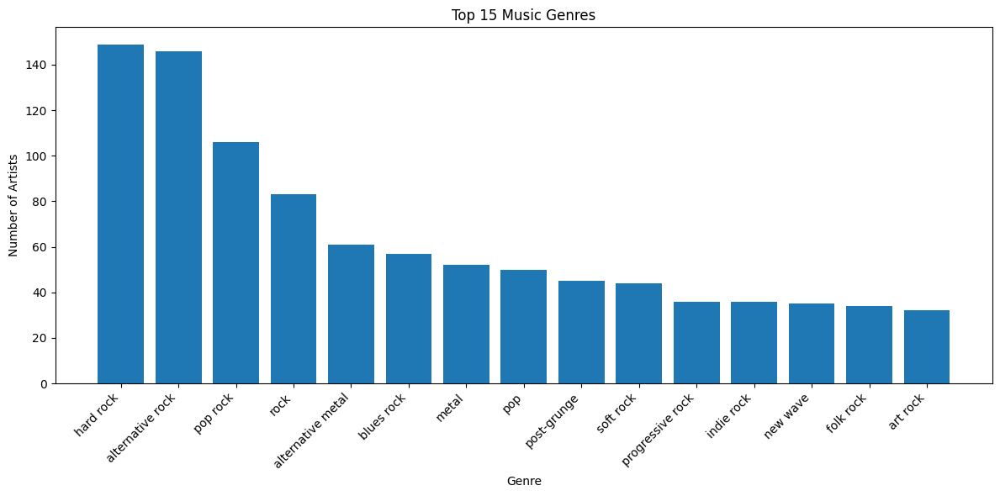

In [27]:
# Extract genres for all artists in the graph
if os.listdir('../graphs').count('artist_genres.pkl'):
    with open('../graphs/artist_genres.pkl', 'rb') as f:
        artist_genres = pickle.load(f)
else:
    artist_genres = extract_all_genres(G_undirected)

# Save the results to avoid re-scraping
with open('../graphs/artist_genres.pkl', 'wb') as f:
    pickle.dump(artist_genres, f)

# Report statistics
stats = report_genre_statistics(artist_genres)

Now that we have the genres, let's use them - and see how community-like the community is, if we consider the genres to be community labels.


*Exercise*: Use the concept of modularity to explore how _community-like_ the genres are.
> 
> * Explain the concept of modularity in your own words.
>   * Modularity indicates how good a division of a network into community is. Networks with high modularity have denser connection within nodes in the same community and sparser connection within nodes in different communities. In particular a comminuty is connected to other communities by edges with high edge betweeness.
> * Work from the undirected version of the network, keeping only the nodes for which you have genre information. 
> * Now create your own partition of the network into genres.
>      * **Each node is simply characterized by the *first genre* in its list of genres**.
>      * Each community is the group of nodes that share the same genre.
>      * That's all you need, now calculate the modularity of this division of the network into genres.
>      * **Note**: Modularity is described in the _Network Science_ book, section 9.4.. Thus, use **equation 9.12** in the book to calculate the modularity $M$ of the partition described above. Are the genres good communities?
> * Thinking a bit about the underlying data, a potential issue is the following: Many artists have the genre `rock` as their first genre in the list (since we started from a list of `rock` bands). So if `rock` is a big community, the network won't have very high modularity.
>      * What happens to the modularity if you use a random genre from the list genre as the node-label for those nodes with more than one genre listed?
>           * This serves as a baseline, and the modularity score being very low resembles that (0.0683). In particular it indicates that random assigning of generes form an artist's list creates a partition with little to none correlation with the actual community structure. 
> * Discuss your findings - and decide how you want to settle on a single genre for each band.  

<div class="alert alert-block alert-info">
Overall, it's OK to use an LLM to help with the code here. But do write your own explanation of modularity, and do try to implement a modularity on your own from eq 9.12 in the book.
</div>

In [28]:
def modularity(graph, partition):
    "Given a graph and a partition of its nodes into communities, compute the modularity of the partition"
    L = graph.number_of_edges()
    Q = 0.0
    for community in partition:
        subgraph = graph.subgraph(community)
        Lc = subgraph.number_of_edges()
        kc = sum(dict(subgraph.degree()).values())
        Q += Lc / L - (kc / (2 * L)) ** 2
    return Q

In [29]:
nodes_with_genres = list(artist_genres.keys())
subgraph = G_undirected.subgraph(nodes_with_genres)

# partitions based on first genre
genre_to_artists = {}
for artist, genres in artist_genres.items():
    if not genres:
        continue
    first_genre = genres[0]
    if first_genre not in genre_to_artists:
        genre_to_artists[first_genre] = []
    genre_to_artists[first_genre].append(artist)

first_genre_partition = list(genre_to_artists.values())
first_genre_modularity = modularity(subgraph, first_genre_partition)
print(f"Modularity based on first genre: {first_genre_modularity:.4f}")
print(f"Number of communities: {len(first_genre_partition)}")
print(f"Distribution of community sizes: {sorted([len(comm) for comm in first_genre_partition], reverse=True)[:10]}")

# partition based on first non-rock genre
non_rock_genre_to_artists = {}
for artist, genres in artist_genres.items():
    if not genres:
        continue
    # first genre that's not 'rock'
    non_rock_genre = None
    for genre in genres:
        if genre.lower() != 'rock':
            non_rock_genre = genre
            break
    
    if non_rock_genre is None:
        non_rock_genre = genres[0]
    
    if non_rock_genre not in non_rock_genre_to_artists:
        non_rock_genre_to_artists[non_rock_genre] = []
    non_rock_genre_to_artists[non_rock_genre].append(artist)

non_rock_partition = list(non_rock_genre_to_artists.values())
non_rock_modularity = modularity(subgraph, non_rock_partition)
print(f"\nModularity based on first non-rock genre: {non_rock_modularity:.4f}")
print(f"Number of communities: {len(non_rock_partition)}")
print(f"Distribution of community sizes: {sorted([len(comm) for comm in non_rock_partition], reverse=True)[:10]}")

# partition based on random genre
random_genre_to_artists = {}
for artist, genres in artist_genres.items():
    if not genres:
        continue
    random_genre = random.choice(genres)
    
    if random_genre not in random_genre_to_artists:
        random_genre_to_artists[random_genre] = []
    random_genre_to_artists[random_genre].append(artist)

random_partition = list(random_genre_to_artists.values())
random_modularity = modularity(subgraph, random_partition)
print(f"\nModularity based on random genre: {random_modularity:.4f}")
print(f"Number of communities: {len(random_partition)}")
print(f"Distribution of community sizes: {sorted([len(comm) for comm in random_partition], reverse=True)[:10]}")

Modularity based on first genre: 0.1647
Number of communities: 79
Distribution of community sizes: [73, 64, 50, 20, 16, 16, 15, 13, 12, 11]

Modularity based on first non-rock genre: 0.1405
Number of communities: 87
Distribution of community sizes: [66, 59, 25, 21, 17, 16, 15, 14, 13, 12]

Modularity based on random genre: 0.0714
Number of communities: 118
Distribution of community sizes: [44, 32, 24, 21, 20, 17, 15, 14, 13, 11]


*Exercise*: Community detection to find **structral communities** in the network
> * Again, work only with the subnetwork of nodes that have at least one genre.
> * Use [the Louvain-algorithm](https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.community.louvain.louvain_communities.html) to find communities for the network. Report the value of modularity found by the algorithm. 
>     * **Note**: You can also try the *Infomap* algorithm instead if you're curious. Go to http://www.mapequation.org/code.html and search for 'python'. It's harder to install, but a better community detection algorithm.
> * What is the modularity of this partitioning of the network? Is it more community-like than the genres? What does this comparison reveal about the communities?
>   * The modularity found by Louvian algorithm is 0.49. The structural communities detected by the algorithm are much more "community-like" than the genre-based groupings. The communities seem not to map cleanly with just their genre classification.
> * Visualize the network, using the Force Atlas algorithm.
>     * This time assign each node a different color based on its structural _community_.
>     * **Note**: If there's a lot of small communities, it's OK to only color the 5-10 largest communities (you can make the remaing nodes light gray or some netural color)
>     * Describe the structure you observe.
>           * The force atlas plot reveals the 4 distinct communities detected by Louvian algorithm. They represent different regions of the graph hinting to a possible communitiy distinction. There is some overlapping between the green and pink community but it's not a major overlap. 
> * Keep using the community labels from above, but now visualize only the backbone-edges from your favorite network backbone from last week. Do the community correspond to the backbone structure you detected?
>   * Yes indeed. The communities correspond to the backbone structure and the little overlapping between the pink and green is still present indicating that there might be a relevant distinction of those particular nodes that are preserved by their critical links (links with high betweenness).
<div class="alert alert-block alert-info">
It's OK to use an LLM to help with the code here. 
</div>

In [30]:
# Louvain algorithm
louvain_communities = nx_comm.louvain_communities(subgraph)
louvain_modularity = modularity(subgraph, louvain_communities)
print(f"Louvain algorithm found {len(louvain_communities)} communities.")
print(f"The modularity of this partition is: {louvain_modularity:.4f}")
sorted_communities = sorted(louvain_communities, key=len, reverse=True)
print(f"Distribution of Louvain community sizes: {[len(c) for c in sorted_communities[:10]]}")

Louvain algorithm found 6 communities.
The modularity of this partition is: 0.4844
Distribution of Louvain community sizes: [165, 126, 78, 65, 49, 4]


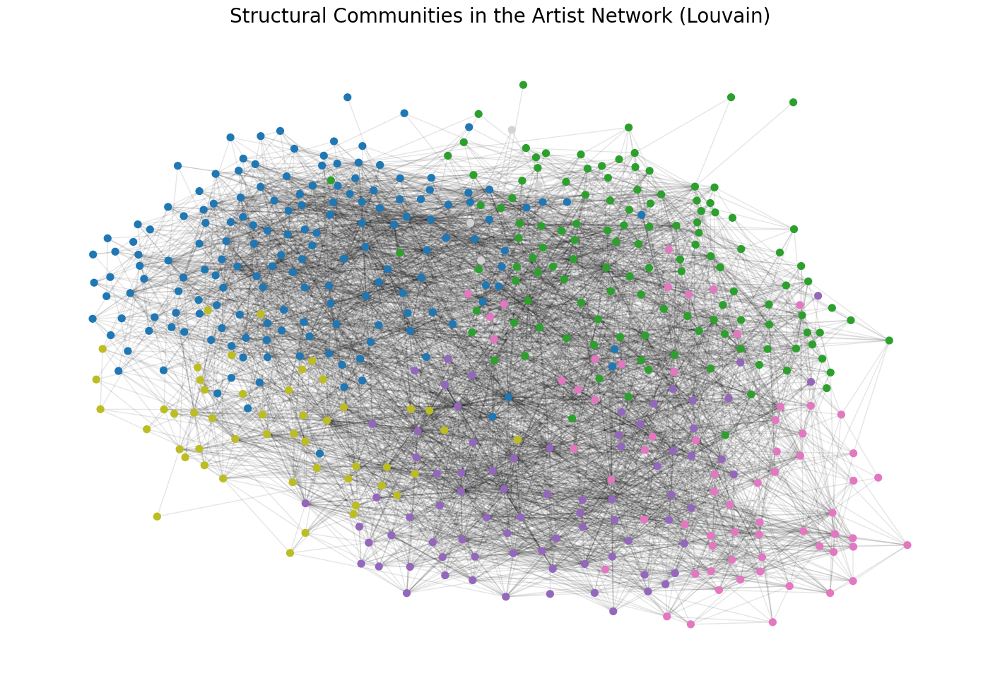

In [31]:
# ForceAtlas2 layout
pos_array = forceatlas2.forceatlas2(nx.to_numpy_array(subgraph), gravity=0.1)
pos_subgraph = {node: pos_array[i] for i, node in enumerate(subgraph.nodes())}

# color mapping from node to community index
node_to_community = {}
for i, comm in enumerate(sorted_communities):
    for node in comm:
        node_to_community[node] = i

top_n = 5
cmap = plt.colormaps.get_cmap('tab10')
colors = [cmap(i / top_n) for i in range(top_n)]

node_colors = []
for node in subgraph.nodes():
    community_index = node_to_community.get(node, -1)
    if community_index < top_n:
        node_colors.append(colors[community_index])
    else:
        node_colors.append('lightgray')

plt.figure(figsize=(18, 12))
nx.draw_networkx_edges(subgraph, pos_subgraph, alpha=0.1)
nx.draw_networkx_nodes(subgraph, pos_subgraph, node_color=node_colors, node_size=50)
plt.title('Structural Communities in the Artist Network (Louvain)', fontsize=20)
plt.axis('off')
plt.show()

Calculating DF score...


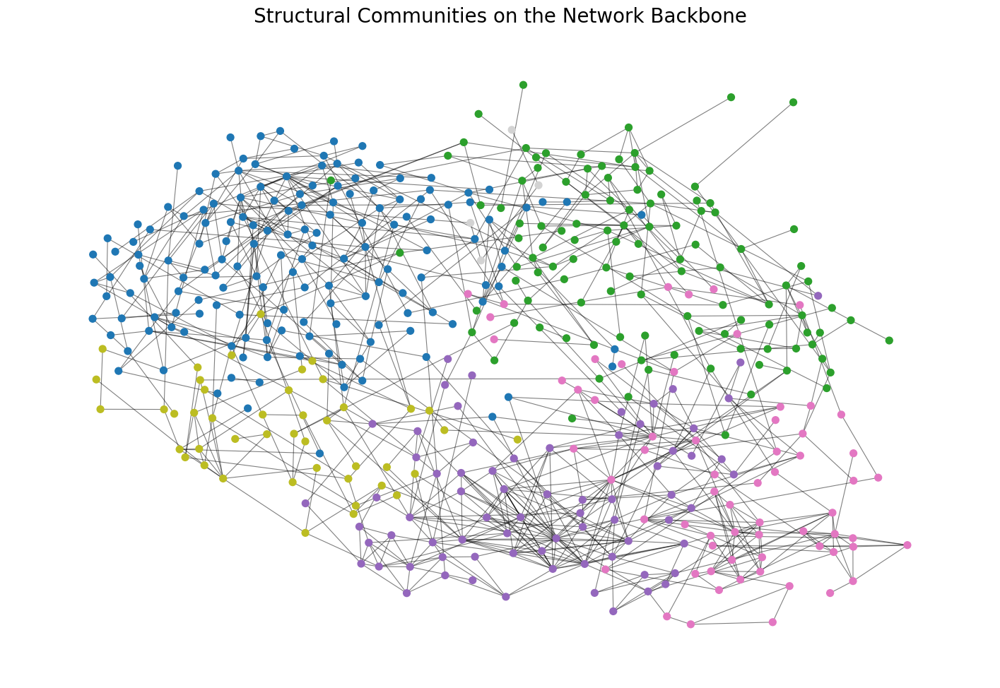

In [32]:
edge_betweenness = nx.edge_betweenness_centrality(G_undirected)

# weighted graph based on edge betweenness
G_w1 = G_undirected.copy()
eb_values = list(edge_betweenness.values())
min_val, max_val = min(eb_values), max(eb_values)
for edge, eb in edge_betweenness.items():
    G_w1.edges[edge]['weight'] = eb

# pandas DataFrame for the backboning library
table_w1 = nx.to_pandas_edgelist(G_w1, source='src', target='trg')
table_w1.rename(columns={'weight': 'nij'}, inplace=True)

alpha = 0.4
df_backbone1 = bb.disparity_filter(table_w1, undirected=True)
backbone_1_table = df_backbone1[df_backbone1['score'] < alpha]
backbone_1 = nx.from_pandas_edgelist(backbone_1_table, 'src', 'trg', create_using=nx.Graph())
backbone_subgraph = backbone_1.subgraph(subgraph.nodes())

backbone_node_colors = []
for node in backbone_subgraph.nodes():
    community_index = node_to_community.get(node, -1)
    if community_index < top_n:
        backbone_node_colors.append(colors[community_index])
    else:
        backbone_node_colors.append('lightgray')

plt.figure(figsize=(18, 12))
nx.draw_networkx_edges(backbone_subgraph, pos_subgraph, alpha=0.5, width=0.8)
nx.draw_networkx_nodes(backbone_subgraph, pos_subgraph, node_color=backbone_node_colors, node_size=50)
plt.title('Structural Communities on the Network Backbone', fontsize=20)
plt.axis('off')
plt.show()

Ok, now in this final community exercise, we want to check if the genres align with the communities.


> *Exercise*: Communities versus genres.
> * Compare the communities found by your algorithm with the music genres by creating a matrix $D$ with dimension ($G \times C$), where G is the 7 most common genres and C is the 7 most common communities. We set entry $D(i,j)$ to be the number of nodes that genre $i$ has in common with community $j$. The matrix $D$ is what we call a confusion matrix.
> * Use the confusion matrix to explain how well the communities you've detected correspond to the genres.
>     * **Note**: This time, use all the genres associate with each node
>     * **Note**: If a node is not characterized by any of the 7 most popular genres, just ignore it.
>     * **Note**: If a node is not part of by any of the 7 largest communiteis, just ignore it.

<div class="alert alert-block alert-info">
Again, you may use an LLM to help with the code for this assignment. The main thing is you get the D matrix right and interpret it.
</div>

Top 7 genres:
0: hard rock (149 occurrences)
1: alternative rock (146 occurrences)
2: pop rock (106 occurrences)
3: rock (83 occurrences)
4: alternative metal (61 occurrences)
5: blues rock (57 occurrences)
6: metal (52 occurrences)

Top 7 communities sizes:
Community 0: 165 nodes
Community 1: 126 nodes
Community 2: 78 nodes
Community 3: 65 nodes
Community 4: 49 nodes
Community 5: 4 nodes

CONFUSION MATRIX D

Rows = Genres, Columns = Communities

Matrix D:
[[21 11 41 43 33  0  0]
 [10 79  8 48  1  0  0]
 [43 38  3 11 11  0  0]
 [60  9  2  1 10  1  0]
 [ 0  2 23 36  0  0  0]
 [30  3  7  4 13  0  0]
 [ 4  1 33  8  6  0  0]]

CONFUSION MATRIX (as DataFrame)
                   Comm 0  Comm 1  Comm 2  Comm 3  Comm 4  Comm 5  Comm 6
hard rock              21      11      41      43      33       0       0
alternative rock       10      79       8      48       1       0       0
pop rock               43      38       3      11      11       0       0
rock                   60       9       2

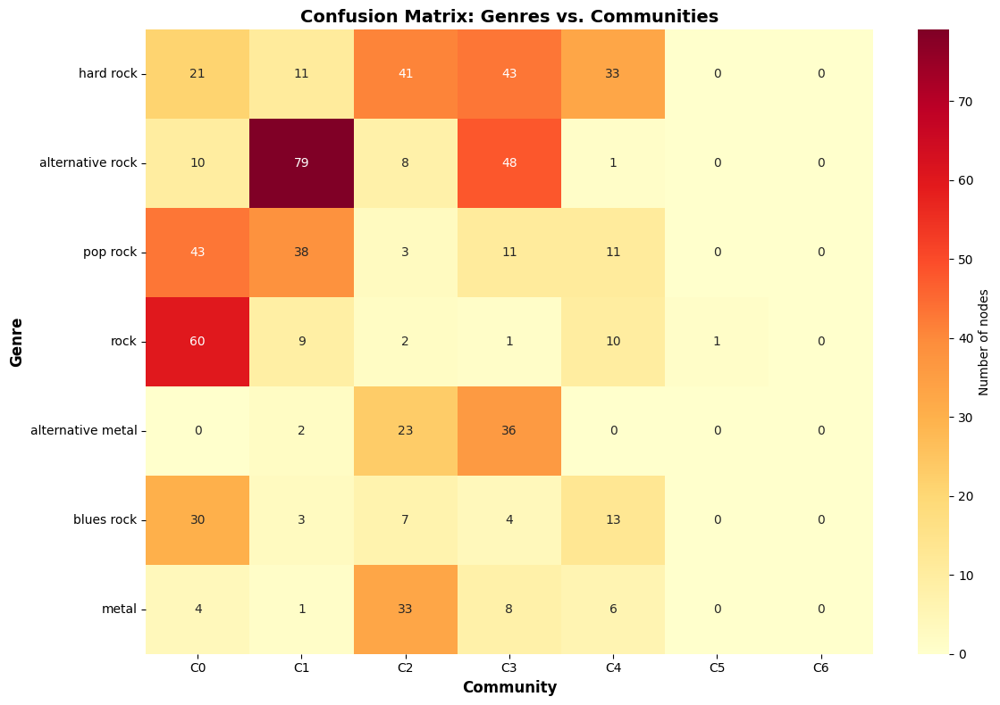


ANALYSIS

Dominant community for each genre:
hard rock            → Community 3 (43/149 = 28.9%)
alternative rock     → Community 1 (79/146 = 54.1%)
pop rock             → Community 0 (43/106 = 40.6%)
rock                 → Community 0 (60/83 = 72.3%)
alternative metal    → Community 3 (36/61 = 59.0%)
blues rock           → Community 0 (30/57 = 52.6%)
metal                → Community 2 (33/52 = 63.5%)

Dominant genre for each community:
Community 0 → rock                 (60/168 = 35.7%)
Community 1 → alternative rock     (79/143 = 55.2%)
Community 2 → hard rock            (41/117 = 35.0%)
Community 3 → alternative rock     (48/151 = 31.8%)
Community 4 → hard rock            (33/74 = 44.6%)
Community 5 → rock                 (1/1 = 100.0%)
Community 6 → hard rock            (0/0 = 0.0%)

Community purity (highest genre concentration):
Community 0: 35.7% pure
Community 1: 55.2% pure
Community 2: 35.0% pure
Community 3: 31.8% pure
Community 4: 44.6% pure
Community 5: 100.0% pure

Genre 

In [50]:
# 7 most common genres
all_genres_flat = [genre for genres_list in artist_genres.values() for genre in genres_list]
genre_counts = Counter(all_genres_flat)
top_7_genres = [genre for genre, _ in genre_counts.most_common(7)]

print("Top 7 genres:")
for i, genre in enumerate(top_7_genres):
    print(f"{i}: {genre} ({genre_counts[genre]} occurrences)")

# 7 largest communities
top_7_communities = sorted_communities[:7]

print(f"\nTop 7 communities sizes:")
for i, comm in enumerate(top_7_communities):
    print(f"Community {i}: {len(comm)} nodes")

# mapping from node to community index
node_to_comm_idx = {}
for i, comm in enumerate(top_7_communities):
    for node in comm:
        node_to_comm_idx[node] = i

# confusion matrix D with dimensions (7 genres × 7 communities)
D = np.zeros((7, 7), dtype=int)

for node, genres in artist_genres.items():
    if node not in node_to_comm_idx:
        continue
    
    comm_idx = node_to_comm_idx[node]
    
    # check all genres for this node
    for genre in genres:
        if genre in top_7_genres:
            genre_idx = top_7_genres.index(genre)
            D[genre_idx, comm_idx] += 1

# display the confusion matrix
print("\n" + "="*80)
print("CONFUSION MATRIX D")
print("="*80)
print("\nRows = Genres, Columns = Communities")
print("\nMatrix D:")
print(D)

df_confusion = pd.DataFrame(
    D,
    index=[f"{genre}" for genre in top_7_genres],
    columns=[f"Comm {i}" for i in range(7)]
)

print("\n" + "="*80)
print("CONFUSION MATRIX (as DataFrame)")
print("="*80)
print(df_confusion)

# heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(D, annot=True, fmt='d', cmap='YlOrRd', 
            xticklabels=[f'C{i}' for i in range(7)],
            yticklabels=top_7_genres,
            cbar_kws={'label': 'Number of nodes'})
plt.xlabel('Community', fontsize=12, fontweight='bold')
plt.ylabel('Genre', fontsize=12, fontweight='bold')
plt.title('Confusion Matrix: Genres vs. Communities', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.savefig('../graphs/confusion_matrix.png', dpi=300, bbox_inches='tight')
plt.show()

print("\n" + "="*80)
print("ANALYSIS")
print("="*80)

# statistics 
print("\nDominant community for each genre:")
for i, genre in enumerate(top_7_genres):
    dominant_comm = np.argmax(D[i, :])
    count = D[i, dominant_comm]
    total = np.sum(D[i, :])
    percentage = (count / total * 100) if total > 0 else 0
    print(f"{genre:20s} → Community {dominant_comm} ({count}/{total} = {percentage:.1f}%)")

print("\nDominant genre for each community:")
for j in range(7):
    dominant_genre_idx = np.argmax(D[:, j])
    dominant_genre = top_7_genres[dominant_genre_idx]
    count = D[dominant_genre_idx, j]
    total = np.sum(D[:, j])
    percentage = (count / total * 100) if total > 0 else 0
    print(f"Community {j} → {dominant_genre:20s} ({count}/{total} = {percentage:.1f}%)")

# Calculate how "pure" each community is (highest genre percentage)
print("\nCommunity purity (highest genre concentration):")
for j in range(7):
    total = np.sum(D[:, j])
    if total > 0:
        max_count = np.max(D[:, j])
        purity = (max_count / total * 100)
        print(f"Community {j}: {purity:.1f}% pure")

print("\nGenre concentration (in dominant community):")
for i, genre in enumerate(top_7_genres):
    total = np.sum(D[i, :])
    if total > 0:
        max_count = np.max(D[i, :])
        concentration = (max_count / total * 100)
        print(f"{genre:20s}: {concentration:.1f}% in dominant community")

# Part 3: Words that characterize pages or groups of pages

Now, we'll begin to play around with how far we can get with simple strategies for looking at text. 

The video is basically just me talking about a fun paper, which shows you how little is needed in order to reveal something highly interesting about humans that produce text. But it's important. Don't miss this one!

> **Video lecture**: Simple methods reveal a lot. I talk about the paper: [Personality, Gender, and Age in the Language of Social Media: The Open-Vocabulary Approach](http://journals.plos.org/plosone/article?id=10.1371/journal.pone.0073791).  

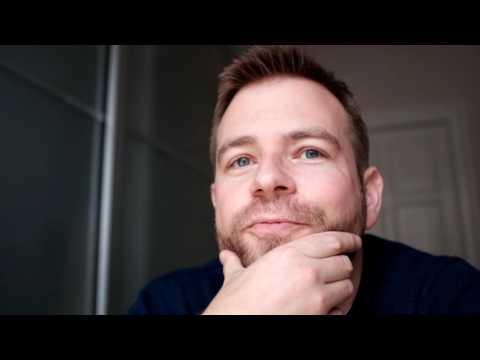

In [33]:
YouTubeVideo("wkYvdfkVmlI",width=800, height=450)

# direct youtube link: https://www.youtube.com/watch?v=wkYvdfkVmlI

_Exercise_: Comparing in the different genres. 

*Setup*. You'll need to go to your archives and find the wikipedia pages of all the rock artists. 

Once you have the texts ready, you will want to aggregate the text into 15 long lists, one for each of the top 15 genres (let's call them 15 *documents*). Each document contains on all the text in that genre (so for the rock genre it's a looooong big doc). In each list, you should keep all the words (or *tokens* to be more precise) that occur on the pages, and a count of how frequently each word occurs. So the format should be

```
word0 count0
word1 count1
word2 count2

...

wordN countN
```
This list is called a ***Term Frequency*** (or TF) list for each genre. Let's build our own TF lists. Before you start counting, I am going to ask you do do a few things

> *Action items*
> * Tokenize the pages into one long string per genre
> * Remove all punctuation from your list of tokens
> * Set everything to lower case
> * (Optional) Lemmatize your words
> * It's a good idea to filter out rare words (e.g. words that only appear less than 5 times).

If you are confused by the instructions for cleaning, go back and have a look at Chapter 3 again. You need to use the tools from the book to clean the text.

> *Action item*: 
> * Create your TF list for each of the 15 most popular genres.
> * List the top 15 words for each genre.
> * Comment on the top 15 words for each genre.

**Note**: Above you (once again) have to deal with the fact that many artists have multiple genres listed. Pick the method you like the best to deal with this. Some possible choices
* Counting each page multiple times, so a page counts once per genre that's listed
* Picking the first genre listed
* Picking the second genre listed
* Picking a random genre
* (... any other heuristic you like, e.g. using an api to ask an LLM to pick the genre that best describes the page from its list)

<div class="alert alert-block alert-info">
It's OK to use an LLM to help with the code here, but write your own comments.
</div>

In [35]:
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\jacop\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\jacop\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jacop\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\jacop\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\jacop\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [36]:
def fetch_wikipedia_text(artist_name):
    """Fetch the full text content from a Wikipedia page."""
    formatted_name = artist_name.replace(" ", "_")
    url = f"https://en.wikipedia.org/wiki/{formatted_name}"
    
    try:
        headers = {'User-Agent': 'Mozilla/5.0 (Jupyter Notebook) Educational project/1.0'}
        response = requests.get(url, headers=headers)
        if response.status_code == 200:
            soup = BeautifulSoup(response.text, 'html.parser')
            
            # remove unwanted elements
            for element in soup(['script', 'style', 'sup', 'span']):
                element.decompose()
            
            # get main content
            content = soup.find('div', {'id': 'mw-content-text'})
            if content:
                # text from paragraphs
                paragraphs = content.find_all('p')
                text = ' '.join([p.get_text() for p in paragraphs])
                return text
        
        # alternative URLs
        for suffix in ['_(band)', '_(musician)']:
            url = f"https://en.wikipedia.org/wiki/{formatted_name}{suffix}"
            response = requests.get(url, headers=headers)
            if response.status_code == 200:
                soup = BeautifulSoup(response.text, 'html.parser')
                for element in soup(['script', 'style', 'sup', 'span']):
                    element.decompose()
                content = soup.find('div', {'id': 'mw-content-text'})
                if content:
                    paragraphs = content.find_all('p')
                    text = ' '.join([p.get_text() for p in paragraphs])
                    return text
        
        return None
    except Exception as e:
        print(f"Error fetching text for {artist_name}: {e}")
        return None

def clean_and_tokenize(text):
    """Clean text and return tokenized, lemmatized words."""
    if not text:
        return []
    
    # Remove URLs, references, punctuation, stopwords, tokenize, and lemmatize
    text = re.sub(r'http\S+|www\S+', '', text)    
    text = re.sub(r'\[.*?\]', '', text)
    tokens = word_tokenize(text)
    tokens = [token.lower() for token in tokens if token not in string.punctuation]
    tokens = [token for token in tokens if not token.isdigit()]
    stop_words = set(stopwords.words('english'))
    tokens = [token for token in tokens if token not in stop_words]
    
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(token) for token in tokens]
    tokens = [token for token in tokens if len(token) > 2]
    
    return tokens

def create_genre_tf_lists(artist_genres, min_word_freq=5):
    """Create TF lists for each genre."""
    # top 15 genres
    all_genres = [genre for genres_list in artist_genres.values() for genre in genres_list]
    genre_counts = Counter(all_genres)
    top_15_genres = [genre for genre, _ in genre_counts.most_common(15)]
    
    print(f"Top 15 genres: {top_15_genres}")
    
    # genre documents
    genre_documents = {genre: [] for genre in top_15_genres}
    
    # fetch and process Wikipedia pages
    print("\nFetching Wikipedia pages...")
    for i, (artist, genres) in enumerate(artist_genres.items()):
        if i % 20 == 0:
            print(f"Processing artist {i}/{len(artist_genres)}: {artist}")
        
        wiki_text = fetch_wikipedia_text(artist)
        if not wiki_text:
            continue
        
        # clean and tokenize
        tokens = clean_and_tokenize(wiki_text)
        
        # add tokens to each genre this artist belongs to allowing counting multiple times
        for genre in genres:
            if genre in top_15_genres:
                genre_documents[genre].extend(tokens)
        
        time.sleep(0.3)
    
    # TF lists
    genre_tf_lists = {}
    for genre, tokens in genre_documents.items():
        word_counts = Counter(tokens)
        # filter rare words
        filtered_counts = {word: count for word, count in word_counts.items() 
                          if count >= min_word_freq}
        genre_tf_lists[genre] = filtered_counts
        print(f"\n{genre}: {len(filtered_counts)} unique words (after filtering)")
    
    return genre_tf_lists, top_15_genres

# create TF lists
if os.path.exists('../graphs/genre_tf_lists.pkl'):
    print("Loading cached TF lists...")
    with open('../graphs/genre_tf_lists.pkl', 'rb') as f:
        genre_tf_lists, top_15_genres = pickle.load(f)
else:
    genre_tf_lists, top_15_genres = create_genre_tf_lists(artist_genres, min_word_freq=5)
    with open('../graphs/genre_tf_lists.pkl', 'wb') as f:
        pickle.dump((genre_tf_lists, top_15_genres), f)

# top 15 words for each genre
print("\n" + "="*80)
print("TOP 15 WORDS FOR EACH GENRE")
print("="*80)

for genre in top_15_genres:
    tf_list = genre_tf_lists[genre]
    top_15_words = sorted(tf_list.items(), key=lambda x: x[1], reverse=True)[:15]
    
    print(f"\n{genre.upper()}:")
    print("-" * 40)
    for word, count in top_15_words:
        print(f"  {word:20s} {count:6d}")

Loading cached TF lists...

TOP 15 WORDS FOR EACH GENRE

HARD ROCK:
----------------------------------------
  band                   9937
  album                  8114
  released               3887
  tour                   3449
  song                   3128
  rock                   3086
  new                    2523
  single                 2330
  first                  2223
  also                   1987
  music                  1954
  record                 1897
  year                   1682
  show                   1605
  time                   1554

ALTERNATIVE ROCK:
----------------------------------------
  band                  10262
  album                  8473
  released               4428
  song                   3917
  tour                   3057
  single                 2951
  music                  2596
  rock                   2490
  first                  2379
  new                    2319
  record                 2050
  also                   1913
  year               

            Genre  Total Words  Unique Words           Top 3 Words Most Common Word  Most Common Count
        hard rock       357584          7323 band, album, released             band               9937
 alternative rock       346805          7213 band, album, released             band              10262
         pop rock       260071          6056 band, album, released             band               6325
             rock       291577          6852     album, band, song            album               5220
alternative metal       140672          4020 band, album, released             band               4697
       blues rock       118691          3763 band, album, released             band               3053
            metal       178546          4755     band, album, tour             band               5321
              pop       193512          5398     album, band, song            album               3246
      post-grunge        64781          2280 band, album, released       

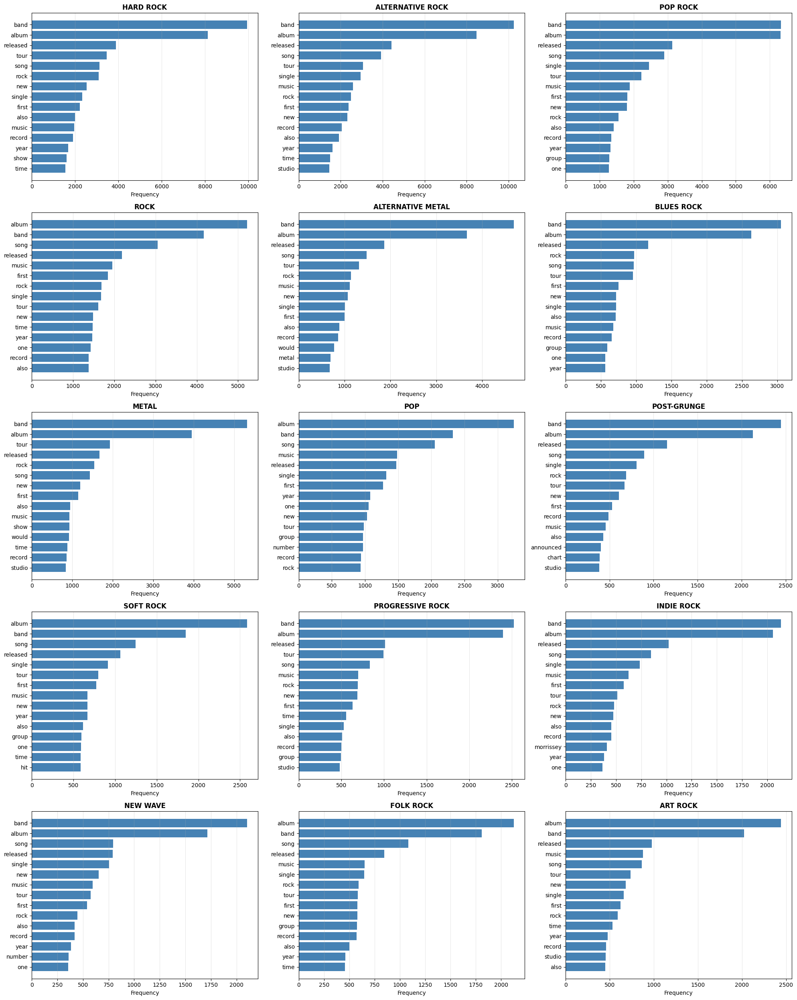

In [39]:
summary_data = []
for genre in top_15_genres:
    tf_list = genre_tf_lists[genre]
    top_words = sorted(tf_list.items(), key=lambda x: x[1], reverse=True)[:15]
    
    summary_data.append({
        'Genre': genre,
        'Total Words': sum(tf_list.values()),
        'Unique Words': len(tf_list),
        'Top 3 Words': ', '.join([w for w, _ in top_words[:3]]),
        'Most Common Word': top_words[0][0] if top_words else 'N/A',
        'Most Common Count': top_words[0][1] if top_words else 0
    })

summary_df = pd.DataFrame(summary_data)
print(summary_df.to_string(index=False))

# visualize word frequency distributions
fig, axes = plt.subplots(5, 3, figsize=(20, 25))
axes = axes.flatten()

for idx, genre in enumerate(top_15_genres):
    tf_list = genre_tf_lists[genre]
    top_15_words = sorted(tf_list.items(), key=lambda x: x[1], reverse=True)[:15]
    words, counts = zip(*top_15_words)
    
    axes[idx].barh(range(len(words)), counts, color='steelblue')
    axes[idx].set_yticks(range(len(words)))
    axes[idx].set_yticklabels(words)
    axes[idx].invert_yaxis()
    axes[idx].set_xlabel('Frequency')
    axes[idx].set_title(f'{genre.upper()}', fontsize=12, fontweight='bold')
    axes[idx].grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.show()

# Part 4: Visualization

**Step 1: Install the software**

First you must set up your system. The most difficult thing about creating the wordcloud is installing the `WordCloud` module. It's available on GitHub, check out the page [**here**](https://github.com/amueller/word_cloud). 

You should be able to simply install using conda (and all dependencies, etc will be automatically fixed): 

    conda install -c conda-forge wordcloud
 
If you can't get that to work, there is more info on the GitHub page
 * On my system, the module needed the `gcc` compiler installed. If you're not already a programmer, you may have to install that. On Mac you get it by installing the [_command line tools_](http://osxdaily.com/2014/02/12/install-command-line-tools-mac-os-x/). On linux, it's probably already installed. And on Windows I'm not sure, but we'll figure it out during the exercises. 
 * Once that's all set up, you can use `pip` to install the `WordCloud` library, as [detailed on the GitHub page](https://github.com/amueller/word_cloud). But don't forget to use Anaconda's `pip`.
 * There are examples of how to use the module online, see [this page](http://sebastianraschka.com/Articles/2014_twitter_wordcloud.html) for a nice example. If you're interested, you can read about how the package was put together - and how it works [here](http://peekaboo-vision.blogspot.dk/2012/11/a-wordcloud-in-python.html). 

**Step 2: Draw some wordclouds**

> *Action items*
> * Get your lists ready for the word-cloud software
>    - The package needs a single string to work on. The way that I converted my lists to a string was to simply combine all words together in one long string (separated by spaces), repeating each word according to its count. 
>    - The `wordcloud` package looks for collocations in real texts, which is a problem when you make the list as above. The recommended fix is to simply set `collocations = False` as an option when you run the package.
> * Now, create a word-cloud for each genre. Feel free to make it as fancy or non-fancy as you like. Comment on the results. (If you'd like, you can remove stopwords and wiki-syntax - I did a bit of that for my own wordclouds.)

<div class="alert alert-block alert-info">
As above, it's OK to use an LLM to help get the code going. But write your own answers to the questions.
</div>

Saved: ../graphs/wordcloud_hard_rock.png


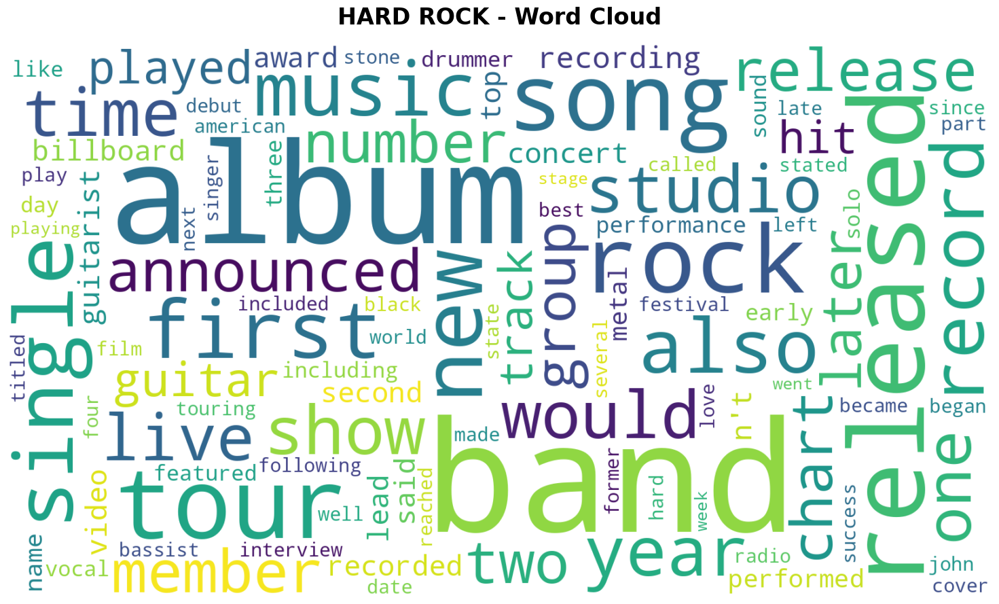

Saved: ../graphs/wordcloud_alternative_rock.png


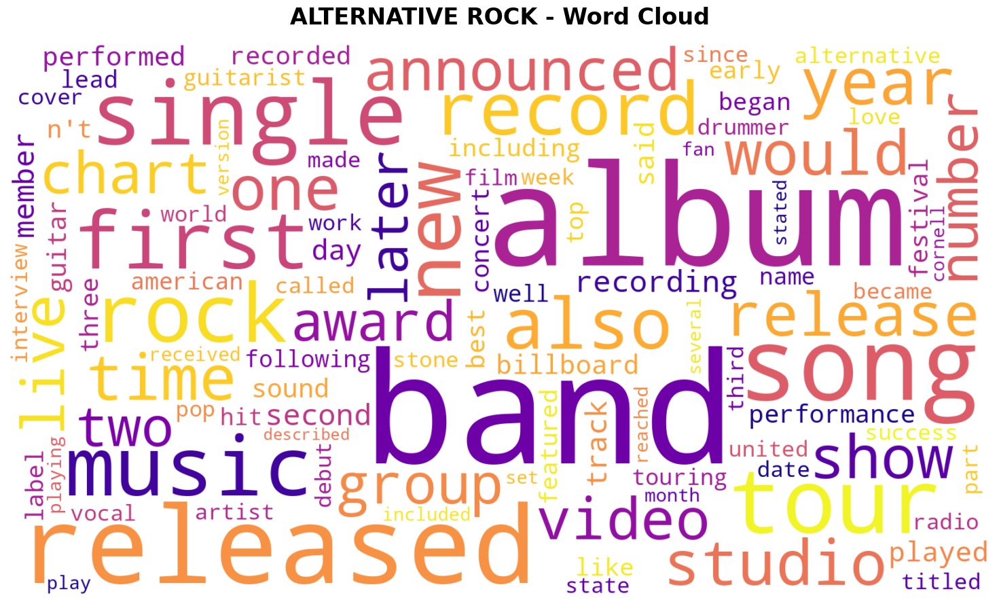

Saved: ../graphs/wordcloud_pop_rock.png


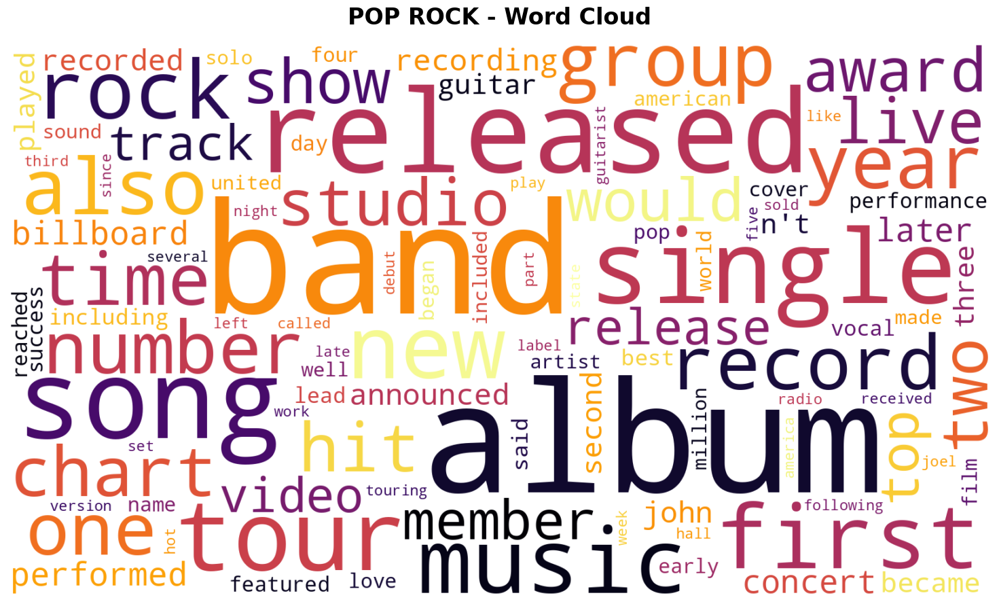

Saved: ../graphs/wordcloud_rock.png


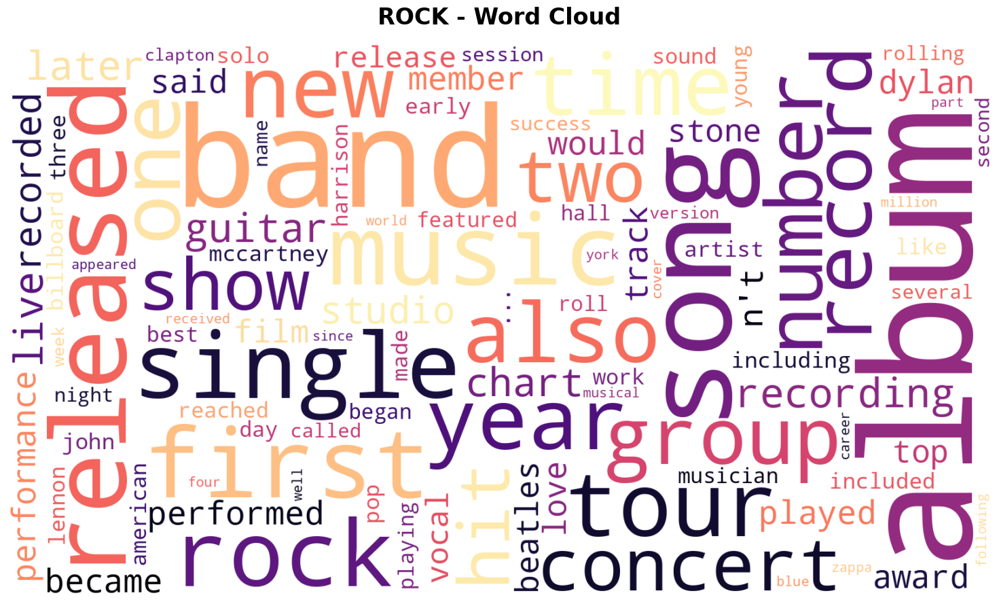

Saved: ../graphs/wordcloud_alternative_metal.png


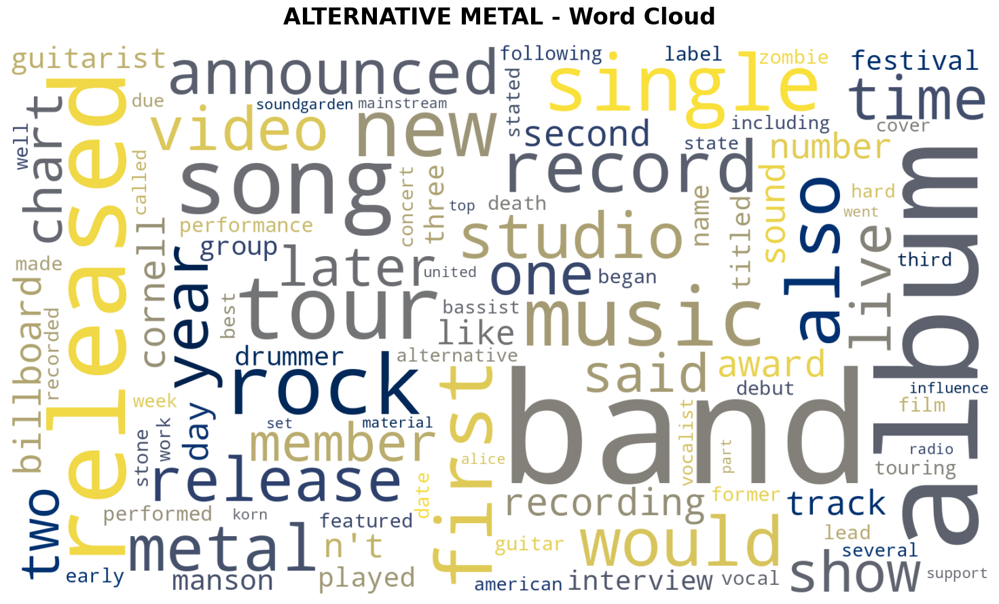

Saved: ../graphs/wordcloud_blues_rock.png


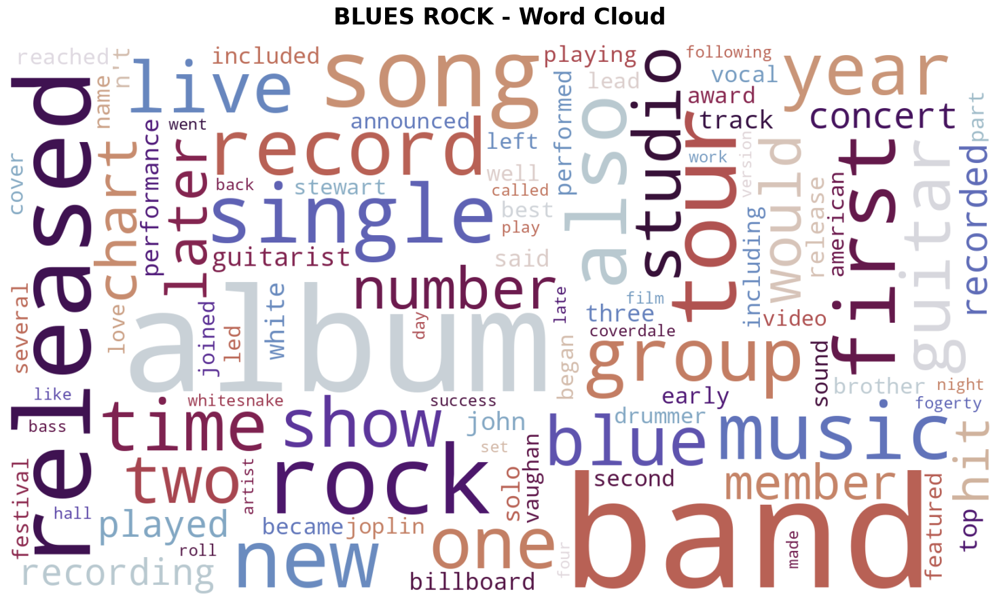

Saved: ../graphs/wordcloud_metal.png


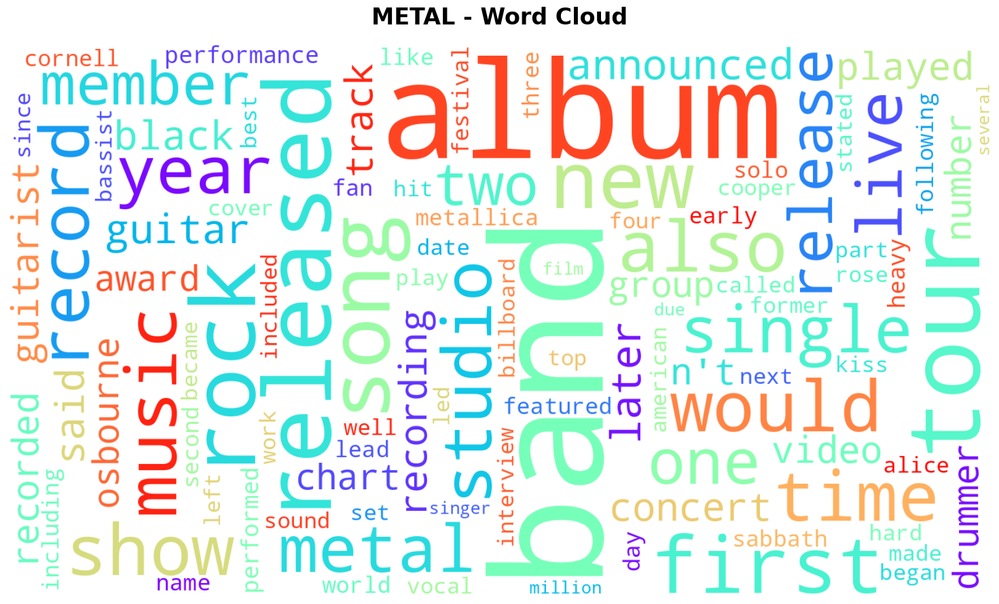

Saved: ../graphs/wordcloud_pop.png


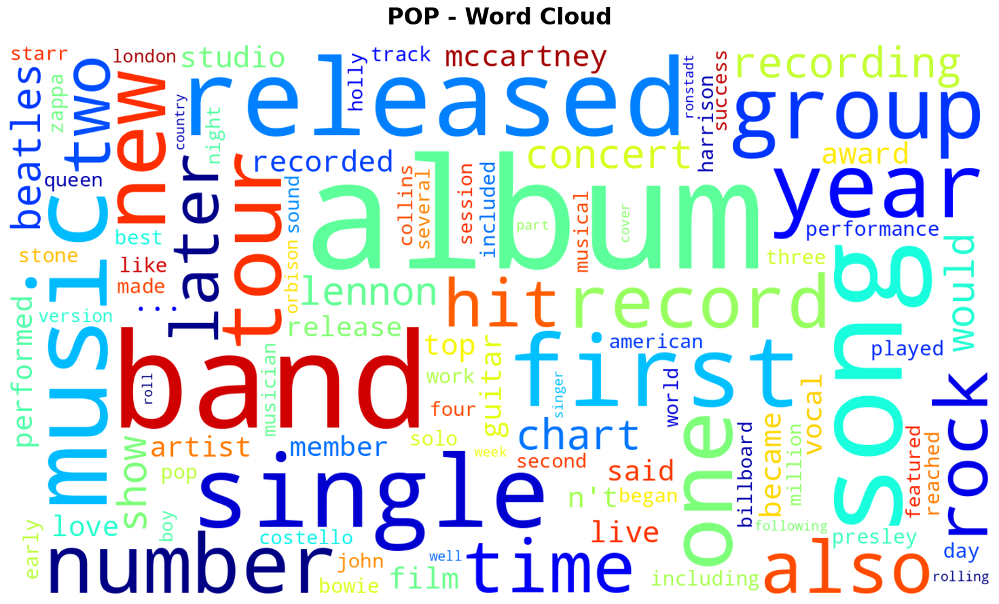

Saved: ../graphs/wordcloud_post-grunge.png


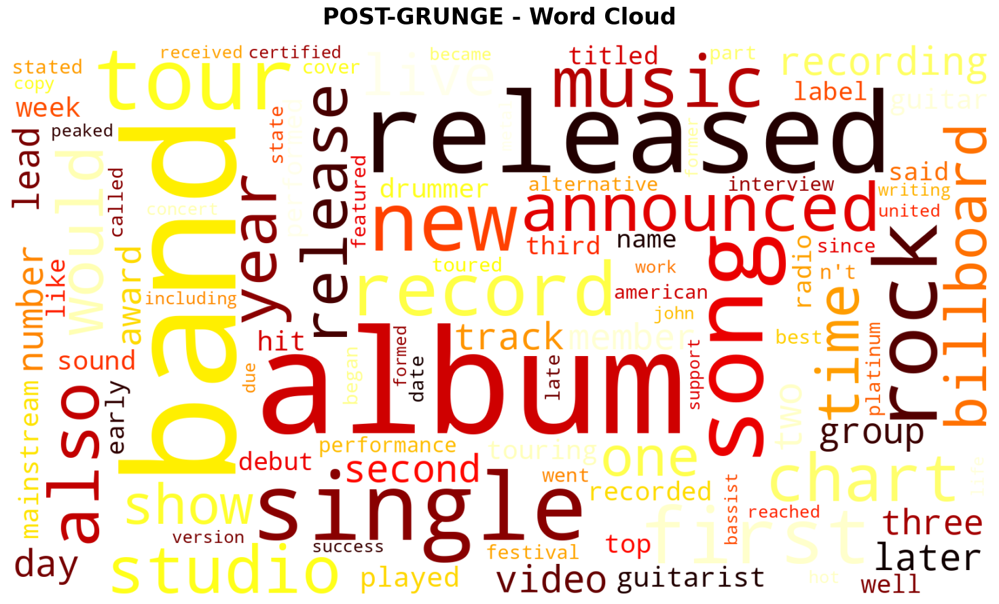

Saved: ../graphs/wordcloud_soft_rock.png


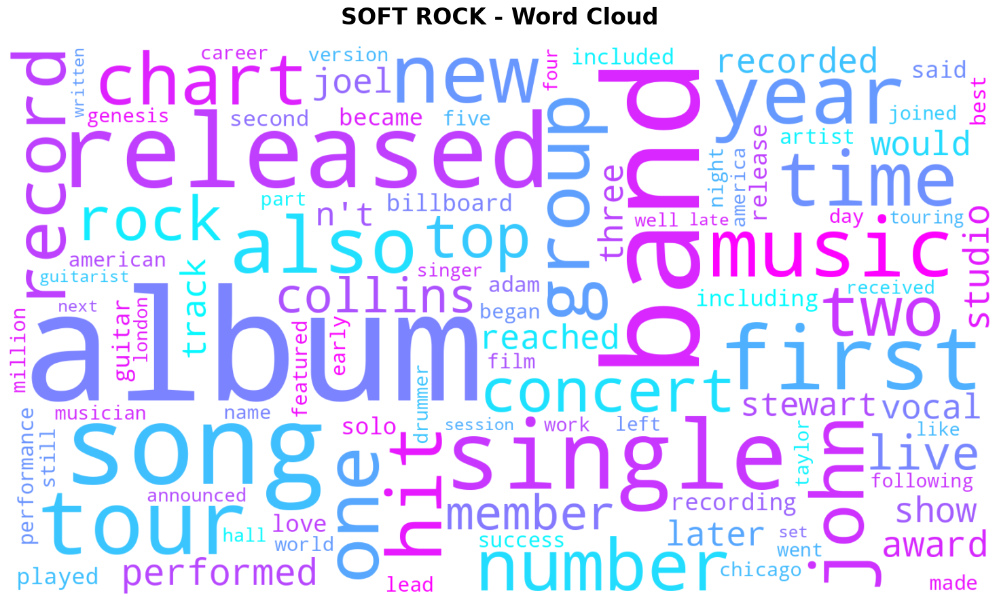

Saved: ../graphs/wordcloud_progressive_rock.png


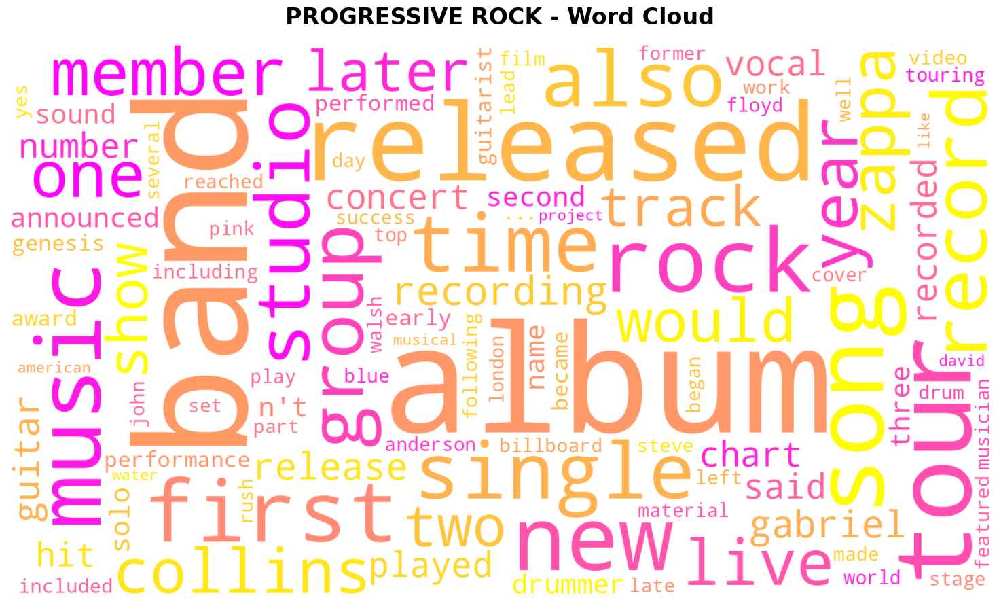

Saved: ../graphs/wordcloud_indie_rock.png


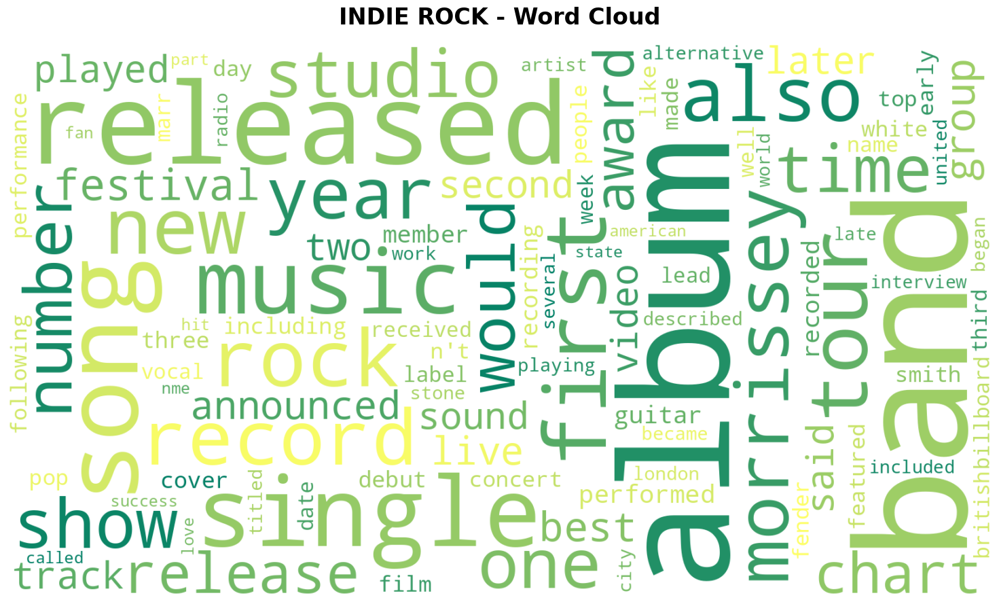

Saved: ../graphs/wordcloud_new_wave.png


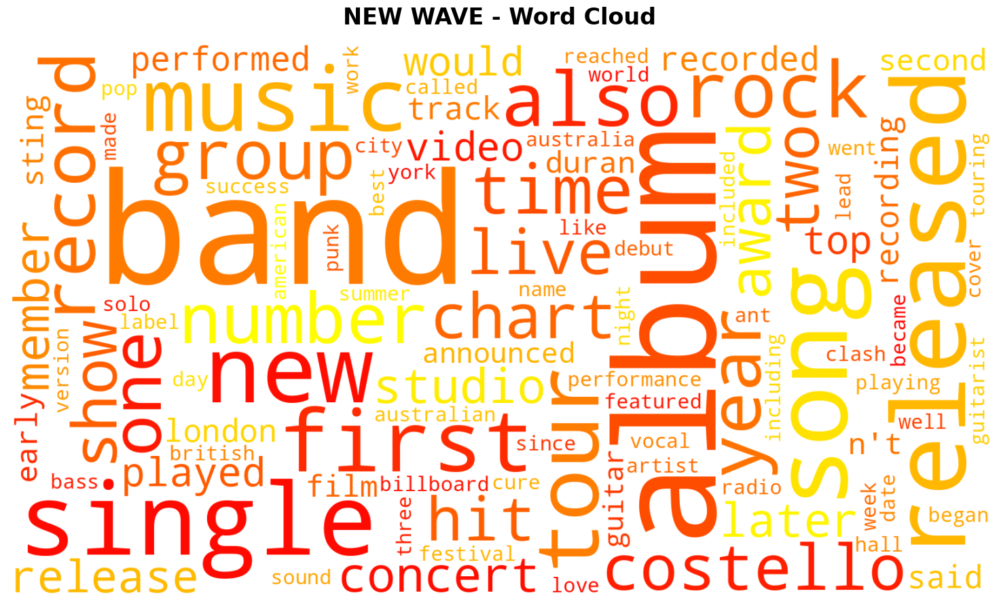

Saved: ../graphs/wordcloud_folk_rock.png


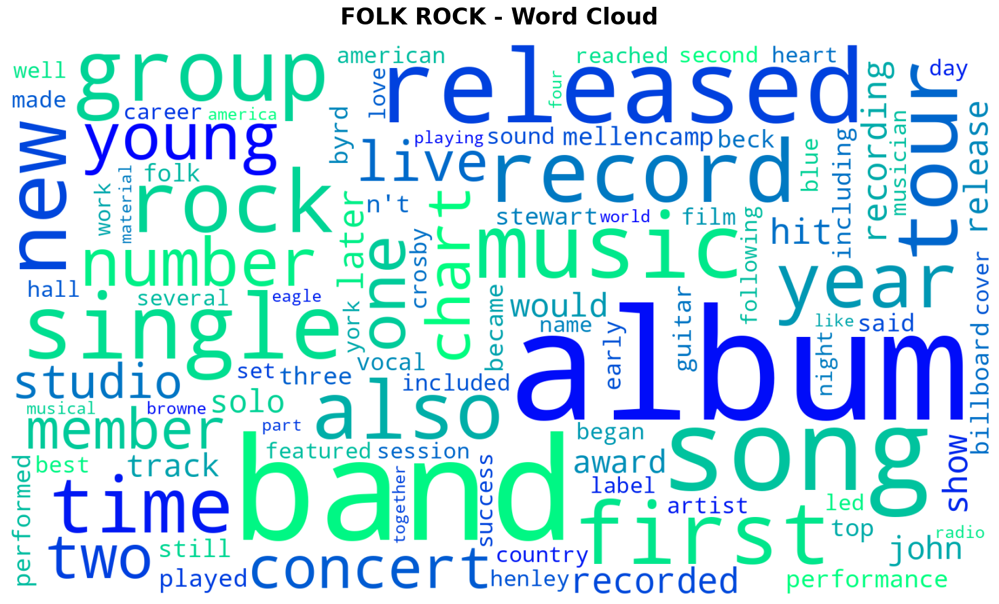

Saved: ../graphs/wordcloud_art_rock.png


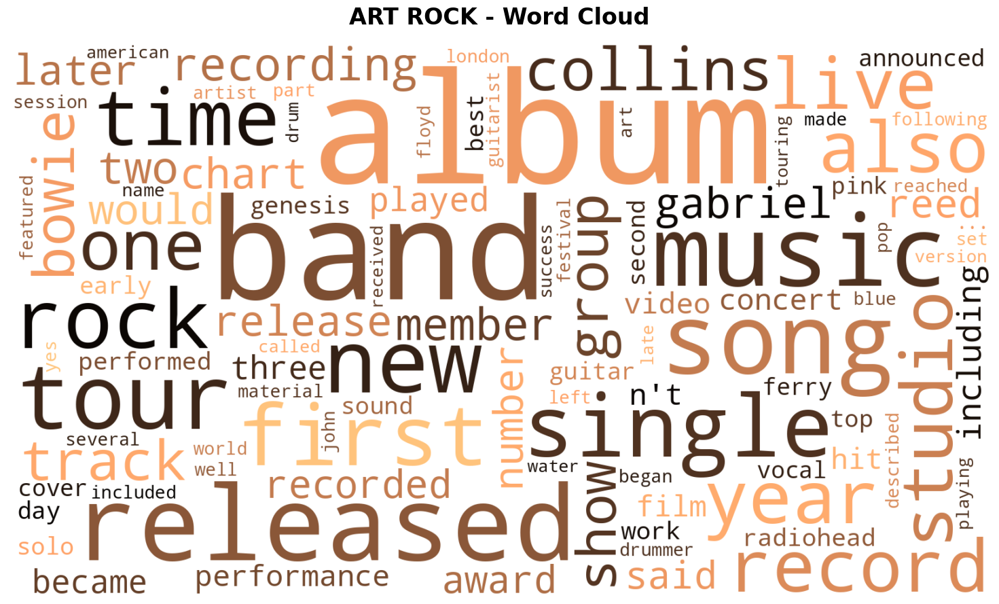

In [ ]:
def create_enhanced_wordcloud(tf_dict, title, colormap='viridis'):
    """Create an enhanced word cloud with custom styling."""
    # additional stopwords
    additional_stopwords = {
        'wikipedia', 'cite', 'web', 'retrieved', 'www', 'http', 
        'archive', 'original', 'archived', 'january', 'february',
        'march', 'april', 'may', 'june', 'july', 'august',
        'september', 'october', 'november', 'december'
    }
    
    cleaned_dict = {word: count for word, count in tf_dict.items() 
                    if word not in additional_stopwords}
    
    wordcloud = WordCloud(
        width=1600, 
        height=900,
        background_color='white',
        colormap=colormap,
        collocations=False,
        max_words=100,
        relative_scaling=0.5,        
        min_font_size=10,
        max_font_size=250,
        prefer_horizontal=0.7,
        margin=10
    ).generate_from_frequencies(cleaned_dict)
    
    return wordcloud

# 15 independent word clouds
colormaps = ['viridis', 'plasma', 'inferno', 'magma', 'cividis', 
             'twilight', 'rainbow', 'jet', 'hot', 'cool',
             'spring', 'summer', 'autumn', 'winter', 'copper']

for idx, genre in enumerate(top_15_genres):
    tf_list = genre_tf_lists[genre]
    cmap = colormaps[idx % len(colormaps)]
    wordcloud = create_enhanced_wordcloud(tf_list, genre, colormap=cmap)
    
    plt.figure(figsize=(16, 9))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'{genre.upper()} - Word Cloud', 
              fontsize=24, fontweight='bold', pad=20)
    plt.axis('off')
    plt.tight_layout()
    
    filename = f'../graphs/wordcloud_{genre.replace(" ", "_")}.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight', facecolor='white')
    print(f"Saved: {filename}")
    
    plt.show()
    plt.close()

In both cases, for the word clouds and the table describing the frequency distribution it's clear that the top words are always the same. `Band` and `album` are usally the top two followed by `song` and `relaesed`. This is to be expected since Wikipedia pages tend to be a narration of an artist's career and a musician usally releases songs or albums and plays in a band.  

# Part 5: Understanding TF-IDF

Now we jump back into the NLP work. In this last part, we'll be creating word-clouds again. But this time, we'll be using the method from the paper I discuss above: TF-IDF. Historically people have had a hard time grasping the idea behind TF-IDF, so here's a little exercise designed to make you study it a bit more carefully.

*Exercise 4*: Wrap your brain around TF-IDF

First, let's learn about TF-IDF the way wikipedia explains it. Check out [the wikipedia page for TF-IDF](https://en.wikipedia.org/wiki/Tf%E2%80%93idf) and ***read the first part very carefully***. The idea is that the term frequency doesn't capture just what's special about a text. It also only captures words that are just frequent in all text. 

This is clear from the top counts in one of my lists:

```
of 
in 
and 
the 
to 
a 
is
by
was
as
ref
with
first
 ```
 
You can fix some of this by removing stop-words (as is described in the book), but it's not enough. ***We want to pull out what's special about a particular text.*** 

To focus on just what's special, TF-IDF has two components: The *term frequency* (TF) and a *weight* (IDF). The weight draws on a larger corpus of text emphasize what's special about the text we're interested in.

Further, there are some extra things going on. For example, there are multiple definitions of TF on wikipedia. Above, we just looked at the raw counts.

> *Action item*
>   * Pick one of the alternative term frequency definitions. Explain why it might sometimes be prefereable to the raw count.
>       * For example the binary term frequency could be better sometimes if there are documents where a single word is repeted so many times. This could skew the document's relevance score. Instead, no matter how many repetition, binary term frequency will only count 1.

Now, let's talk about the inverse document frequency.

> *Action item*
>   * What does IDF stand for? Answer in your own words.
>       * IDF stands for inverse document frequency, it gives an idea on how much information a word provides. It's the log scaled version of the fraction $\frac{N}{n_t}$ where $N$ is all the documents and $n_t$ all the documents containg the specific word.
>   * How does IDF draw on a larger corpus to extract what's special about a certain text? Answer in your own words.
>       * IDF gives a higher score to words that are not common in every document as $\frac{N}{n_t} \longrightarrow 1$ the log approaches 0. This helps in highlighting the meaningful words discarding the common ones.

There are also multiple versions of IDF. Let's think about those for a moment.

> *Action items*
>   * All of the IDF versions take the log of the calculated weight. Why do you think that is?
>       * The log makes it possible to give a score close to 0 to common words (when the fraction $\frac{N}{n_t} \longrightarrow 1$) so it's fundamental for IDF. 
>   * Explain why using IDF makes stopword removal less important.
>       * Stopwords, which are commonly occurring in many texts, are almost discarded since their IDF score is close to 0 the total value of TF-IDF ($TF \cdot IDF$) will be very small.  

<div class="alert alert-block alert-info">
The point of this exercise is to understand TF-IDF. So if there are parts of the wikipedia page you don't understand, I encourage you to ask questions to an LLM to really understand the concept. Perhaps ask it to explain TF-IDF at the level of a high-school student. Once you've done that, then answer the questions in the action items on your own.
</div>

# Part 6: Genres and TF-IDF word-clouds

**But wait a minute!** Now we have all of the ingredients for a wonderful cocktail 😎

* We have genres - descriptions of related nodes in the network. 
* And you're an expert on TF-IDF, so you can extract words that characterize a text relative to everything that's going on.
* Finally, you can create nice WordCouds!

So let's put it all together. Let's use TF-IDF and wordcoulds to build a deeper understanding of the top communities.

Thus, the aim of this final part is to create genre wordclouds for the top 15 genres based on TF-IDF. 

For each genre, create a single document for each community consisting of all the cleaned text from all members of the community. So in the end, you should have 15 documents in total.

_Exercise_: Genre Word-clouds

> * Now that we have the community-texts, let's start by grabbing the TF lists from the exercise above (you may modify to use whichever version of TF you like). 
    > * Next, calculate IDF for every word in every list (use whichever version of IDF you like). 
    >   * Which base logarithm did you use? Is that important?
    >       * I used base $e$ log. The log's base is not foundamental since it only changes the magnitue (as long as it kept the same throughout the calculations). 
> * We're now ready to calculate TF-IDFs. Do that for each genre. 
>   * List the 10 top words for each genre accourding to TF-IDF. Are these 10 words more descriptive of the genre than just the TF? Justify your answer.
>       * I think they are more descriptive since they differ between each genre, altough I am not sure about the meaning or what they refer to for most of them. 
> * Create a wordcloud for each genre.
>     * **Note**: you may have to rescale the TF-IDF weights so they make sense to the wordcloud package. Write about this issue and how you solved it.
>       * I used a scaling function to scale them in the range $[1, 1000]$ since values that are 0 do not work well with the wordcloud library.
> * Explain your creation. Do the wordclouds/TF-IDF lists enable you to understand the communities you have found (or is it just gibberish)? Justify your answer.
>   * For me and my non-existent understaing of rock music it's mostly gibberish. I think some words describe more in depth common aspects of each genre but we will need an expert to evalute how meaningful they are.

<div class="alert alert-block alert-info">
Overall, it's OK to use an LLM to help with the code. But do write your own answers to the questions.
</div>


TOP 10 WORDS BY TF-IDF FOR EACH GENRE

HARD ROCK:
------------------------------------------------------------
  nugent               TF-IDF:   307.40  (TF:   191)
  vai                  TF-IDF:   300.04  (TF:   227)
  loaf                 TF-IDF:   280.07  (TF:   139)
  cornell              TF-IDF:   265.99  (TF:   349)
  osbourne             TF-IDF:   254.55  (TF:   334)
  coverdale            TF-IDF:   240.56  (TF:   182)
  whitesnake           TF-IDF:   230.71  (TF:   210)
  motörhead            TF-IDF:   194.74  (TF:   121)
  scholz               TF-IDF:   189.56  (TF:    70)
  blackmore            TF-IDF:   189.01  (TF:   143)

ALTERNATIVE ROCK:
------------------------------------------------------------
  morrissey            TF-IDF:   669.53  (TF:   416)
  lavigne              TF-IDF:   378.22  (TF:   235)
  cornell              TF-IDF:   325.43  (TF:   427)
  r.e.m                TF-IDF:   233.73  (TF:   116)
  marr                 TF-IDF:   225.32  (TF:   140)
  reznor     

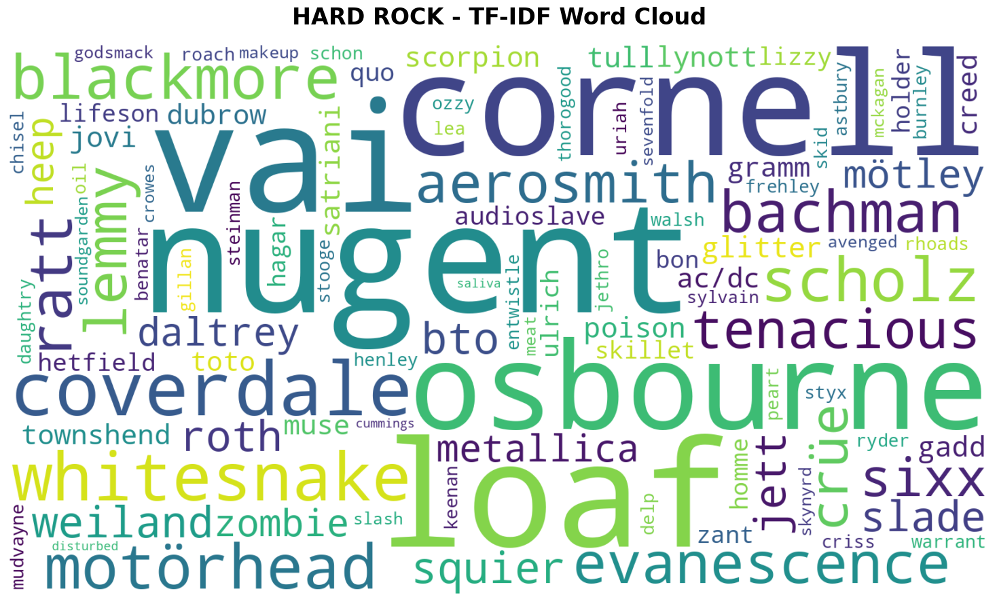

Saved: ../graphs/wordcloud_tfidf_alternative_rock.png


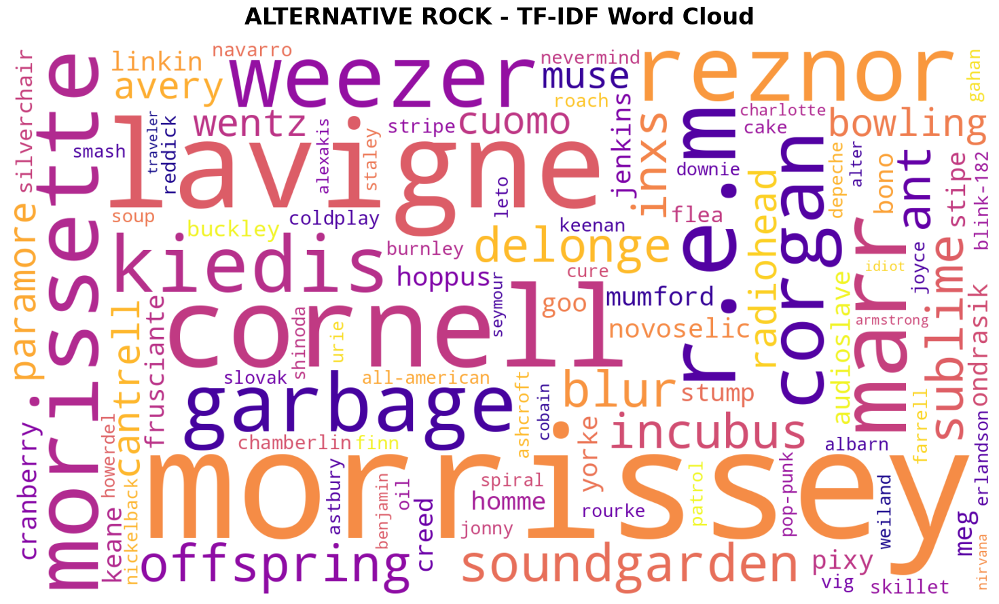

Saved: ../graphs/wordcloud_tfidf_pop_rock.png


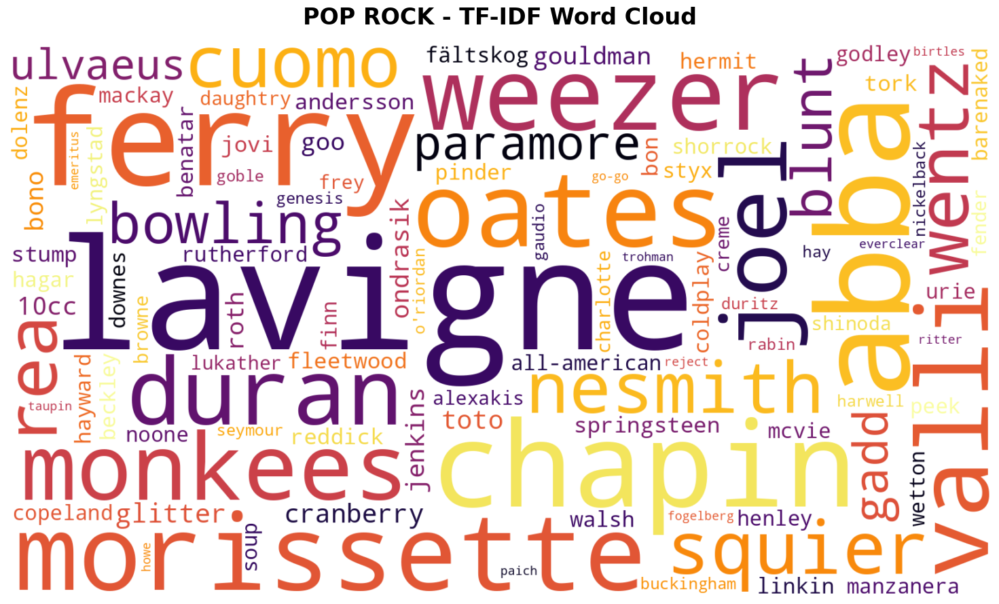

Saved: ../graphs/wordcloud_tfidf_rock.png


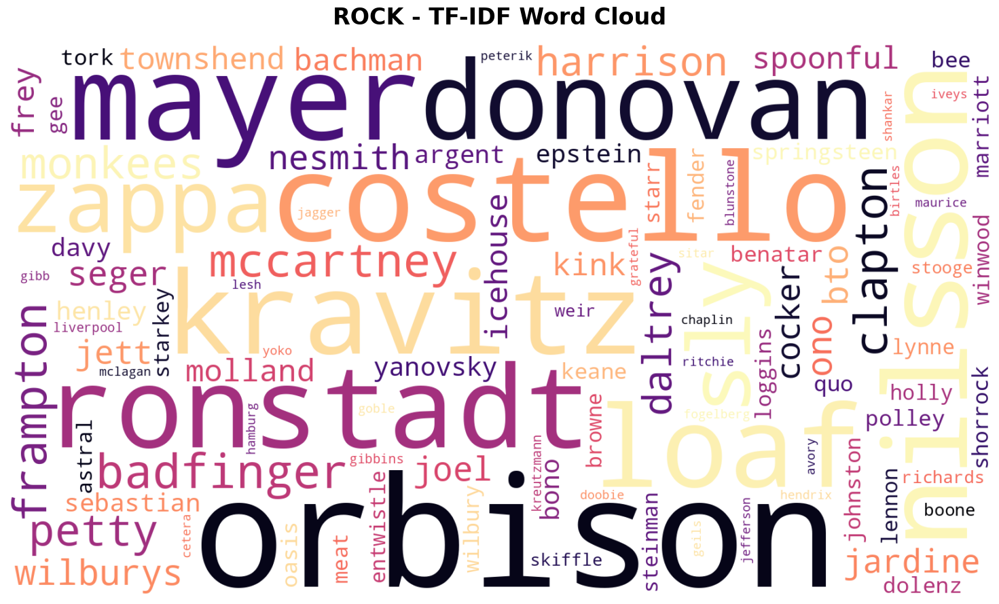

Saved: ../graphs/wordcloud_tfidf_alternative_metal.png


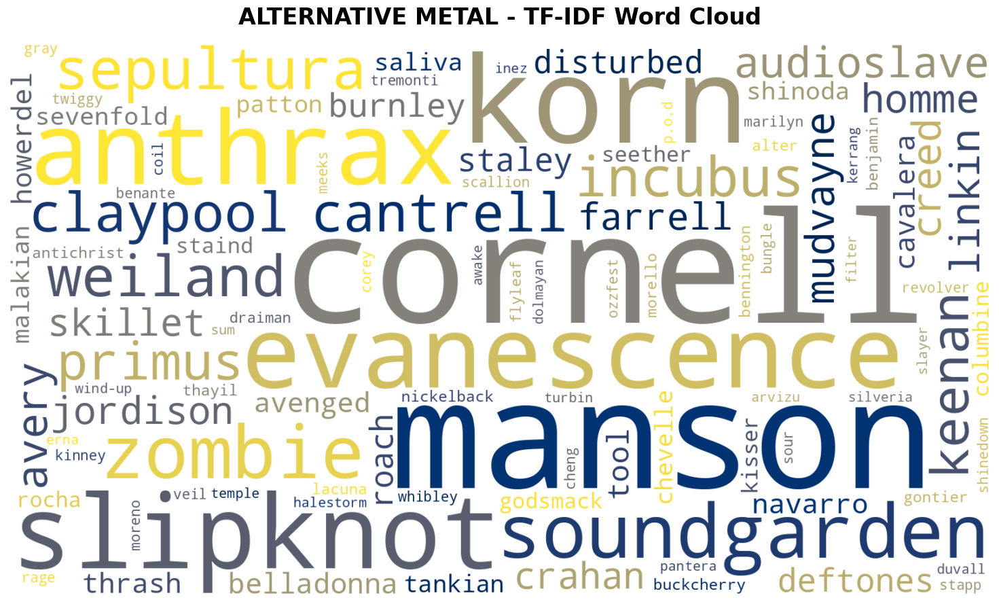

Saved: ../graphs/wordcloud_tfidf_blues_rock.png


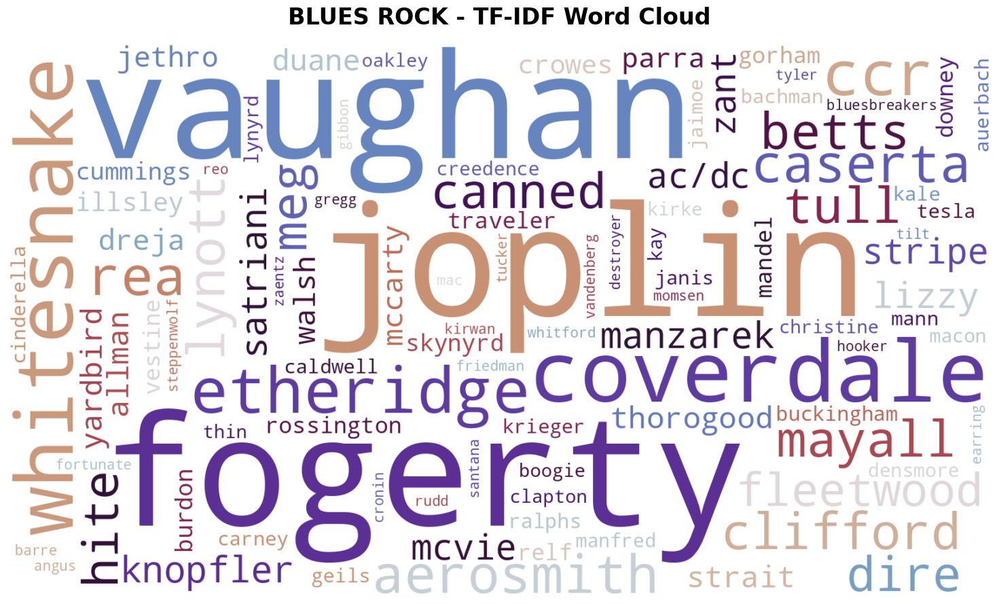

Saved: ../graphs/wordcloud_tfidf_metal.png


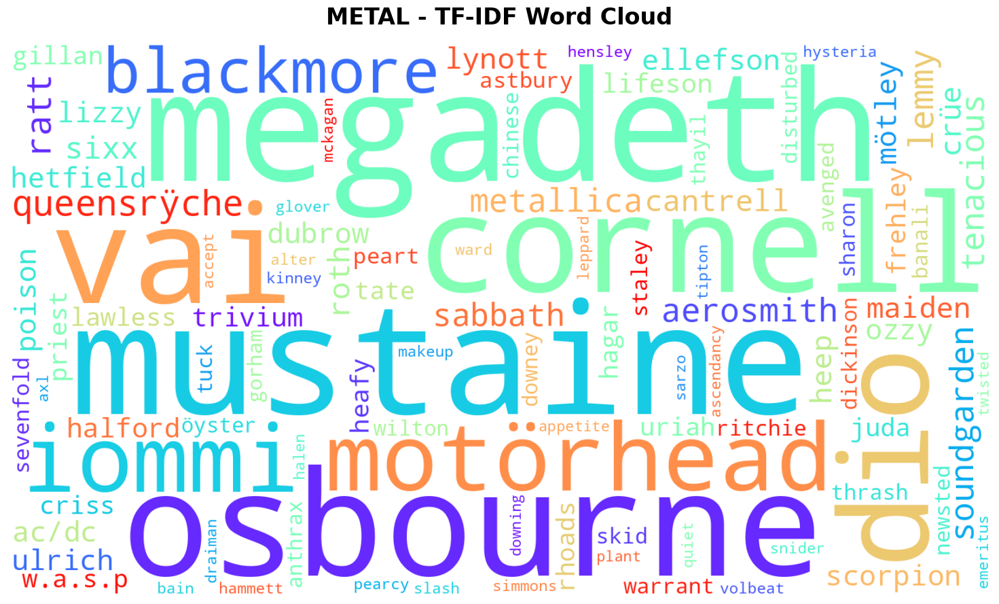

Saved: ../graphs/wordcloud_tfidf_pop.png


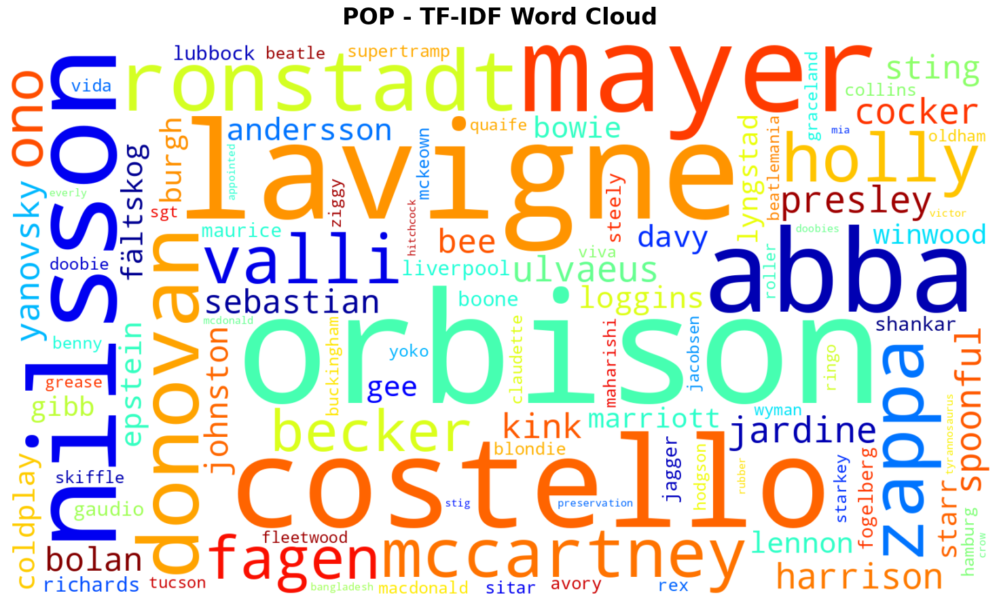

Saved: ../graphs/wordcloud_tfidf_post-grunge.png


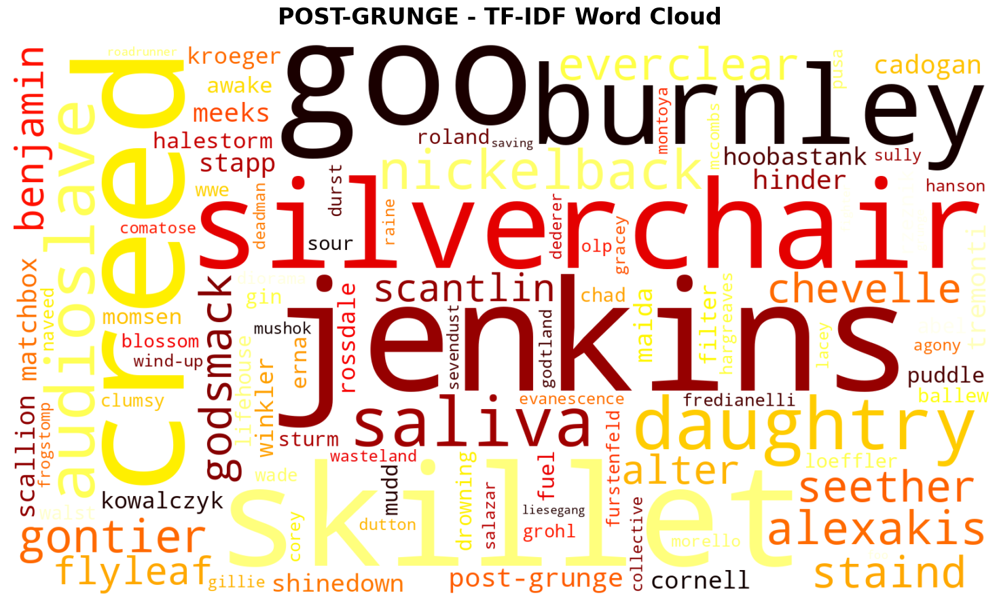

Saved: ../graphs/wordcloud_tfidf_soft_rock.png


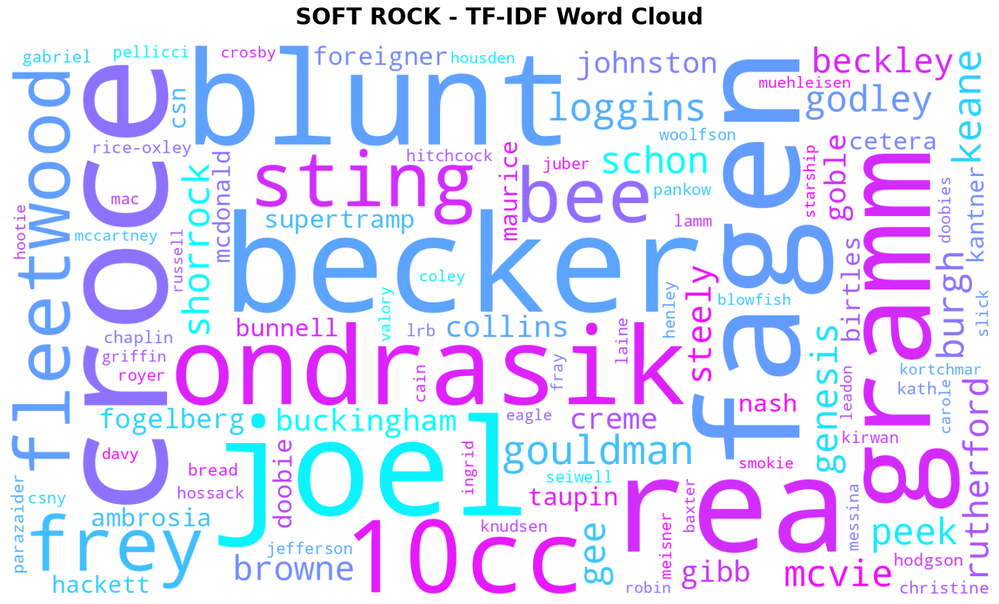

Saved: ../graphs/wordcloud_tfidf_progressive_rock.png


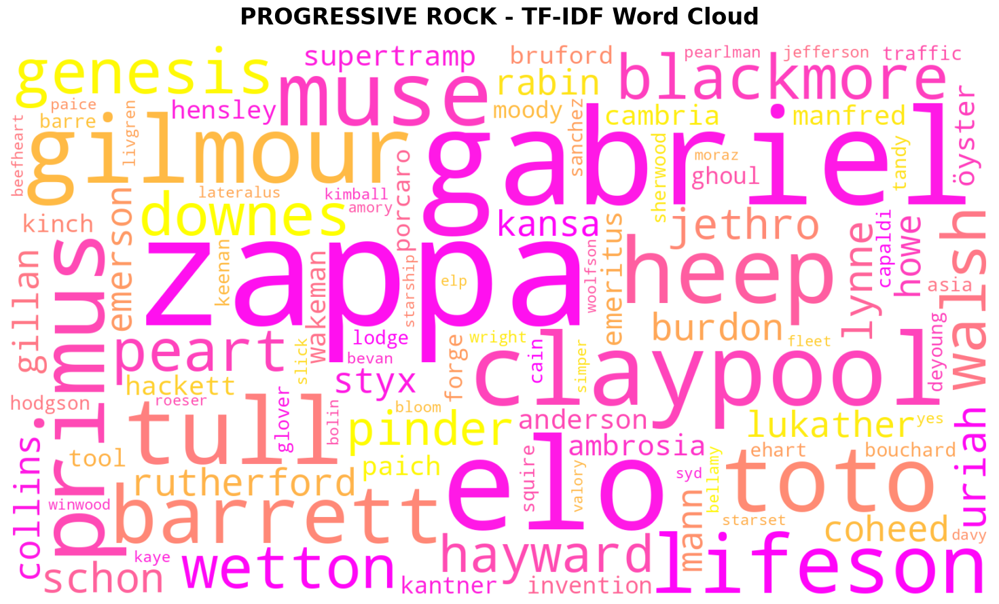

Saved: ../graphs/wordcloud_tfidf_indie_rock.png


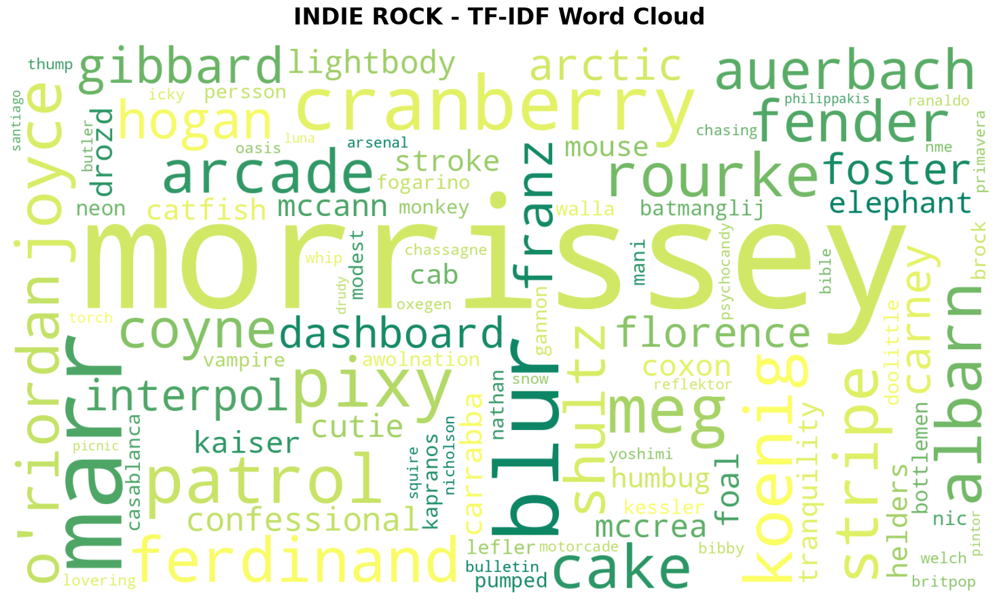

Saved: ../graphs/wordcloud_tfidf_new_wave.png


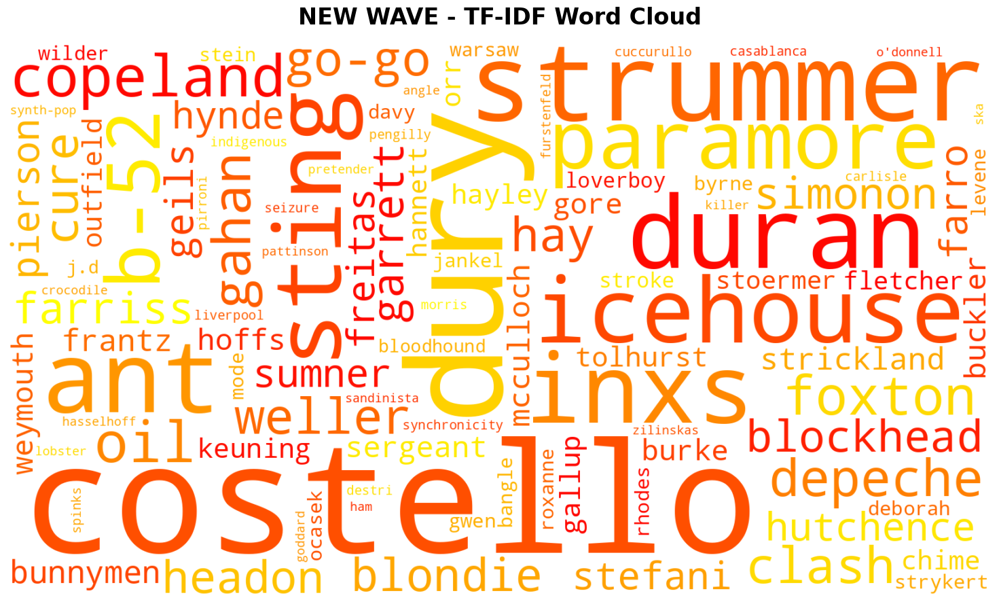

Saved: ../graphs/wordcloud_tfidf_folk_rock.png


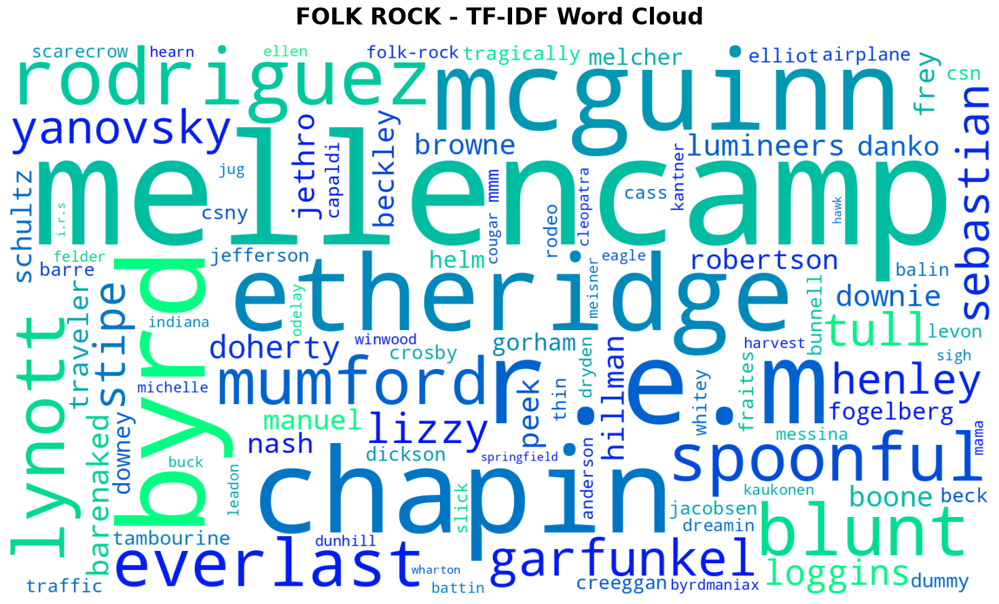

Saved: ../graphs/wordcloud_tfidf_art_rock.png


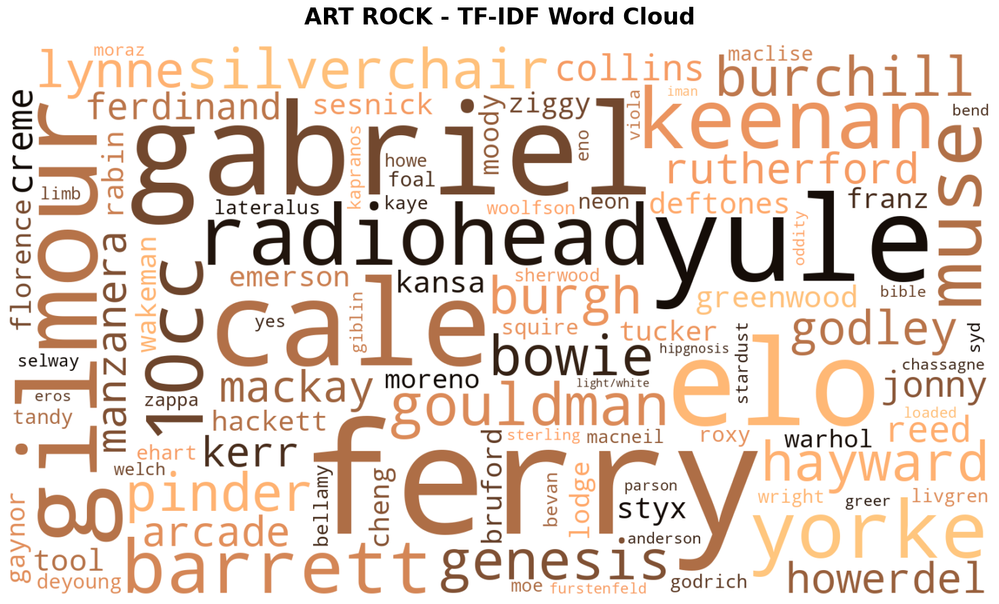

In [57]:
# calculate IDF for all words across all genres
all_words = set()
for genre, tf_dict in genre_tf_lists.items():
    all_words.update(tf_dict.keys())

N = len(top_15_genres)
idf = {}

for word in all_words:
    nt = sum(1 for genre in top_15_genres if word in genre_tf_lists[genre])
    idf[word] = math.log(N/nt)

# TF-IDF for each genre
genre_tfidf = {}

for genre in top_15_genres:
    tf_dict = genre_tf_lists[genre]
    tfidf_dict = {}
    
    for word, tf_count in tf_dict.items():
        tfidf_dict[word] = tf_count * idf[word]
    genre_tfidf[genre] = tfidf_dict

# top 10 TF-IDF words for each genre
print("\n" + "="*80)
print("TOP 10 WORDS BY TF-IDF FOR EACH GENRE")
print("="*80)

for genre in top_15_genres:
    tfidf_dict = genre_tfidf[genre]
    top_10_tfidf = sorted(tfidf_dict.items(), key=lambda x: x[1], reverse=True)[:10]
    
    print(f"\n{genre.upper()}:")
    print("-" * 60)
    for word, score in top_10_tfidf:
        # Also raw TF for comparison
        tf = genre_tf_lists[genre][word]
        print(f"  {word:20s} TF-IDF: {score:8.2f}  (TF: {tf:5d})")

# compare with raw TF
print("\n" + "="*80)
print("COMPARISON: TOP 10 TF vs TOP 10 TF-IDF")
print("="*80)

for idx, genre in enumerate(top_15_genres[:3]):
    print(f"\n{genre.upper()}:")
    
    # top 10 by TF
    tf_dict = genre_tf_lists[genre]
    top_10_tf = sorted(tf_dict.items(), key=lambda x: x[1], reverse=True)[:10]
    top_tf_words = set([word for word, _ in top_10_tf])
    
    # top 10 by TF-IDF
    tfidf_dict = genre_tfidf[genre]
    top_10_tfidf = sorted(tfidf_dict.items(), key=lambda x: x[1], reverse=True)[:10]
    top_tfidf_words = set([word for word, _ in top_10_tfidf])
    
    print(f"  TF only:     {', '.join([w for w, _ in top_10_tf[:5]])}")
    print(f"  TF-IDF only: {', '.join([w for w, _ in top_10_tfidf[:5]])}")
    print(f"  Overlap: {len(top_tf_words & top_tfidf_words)}/10 words")

# create TF-IDF word clouds
print("\n" + "="*80)
print("CREATING TF-IDF WORD CLOUDS")
print("="*80)

# normalize TF-IDF scores for wordcloud
def rescale_tfidf_for_wordcloud(tfidf_dict):
    if not tfidf_dict:
        return {}
    
    min_score = min(tfidf_dict.values())
    max_score = max(tfidf_dict.values())

    if max_score == min_score:
        return {word: 500 for word in tfidf_dict}
    
    # Scale to [10, 1000] range
    rescaled = {}
    for word, score in tfidf_dict.items():
        rescaled[word] = 1 + (score - min_score) * (999 / (max_score - min_score))
    
    return rescaled

colormaps = ['viridis', 'plasma', 'inferno', 'magma', 'cividis', 
             'twilight', 'rainbow', 'jet', 'hot', 'cool',
             'spring', 'summer', 'autumn', 'winter', 'copper']

for idx, genre in enumerate(top_15_genres):
    tfidf_dict = genre_tfidf[genre]
    rescaled_tfidf = rescale_tfidf_for_wordcloud(tfidf_dict)
    additional_stopwords = {
        'wikipedia', 'cite', 'web', 'retrieved', 'www', 'http', 
        'archive', 'original', 'archived', 'january', 'february',
        'march', 'april', 'may', 'june', 'july', 'august',
        'september', 'october', 'november', 'december', 'band',
        'album', 'song', 'released'  # Generic music words
    }
    cleaned_tfidf = {word: score for word, score in rescaled_tfidf.items() 
                     if word not in additional_stopwords}
    
    cmap = colormaps[idx % len(colormaps)]
    wordcloud = WordCloud(
        width=1600, 
        height=900,
        background_color='white',
        colormap=cmap,
        collocations=False,
        max_words=100,
        relative_scaling=0.5,
        min_font_size=10,
        max_font_size=250,
        prefer_horizontal=0.7,
        margin=10
    ).generate_from_frequencies(cleaned_tfidf)
    
    plt.figure(figsize=(16, 9))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'{genre.upper()} - TF-IDF Word Cloud', 
              fontsize=24, fontweight='bold', pad=20)
    plt.axis('off')
    plt.tight_layout()
    
    filename = f'../graphs/wordcloud_tfidf_{genre.replace(" ", "_")}.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight', facecolor='white')
    print(f"Saved: {filename}")
    
    plt.show()
    plt.close()

*Exercise*: Community Word-clouds
> * Redo the exercise above but for the 15 largest structural communities.
> * Do the word clouds seem more meaningful than for the genres? Optional: Add nuance to your answer by considering the confusion matrix $D$ that you calculated above.
>   * To me personally they all seem similar. A lot of specific terms that I am not familiar with. It's hard to say but surley this can be a good way to use the structural communities if you don't have genre-labels.

Note that this is a great way of characterizing the structural communities if you don't have genre-labels (or other labels for that matter).

<div class="alert alert-block alert-info">
Todays exercices are getting, long and involved so you can do whatever parts of this one that you like with LLMs. Maybe you can even get one to solve the whole exercise?
</div>

CREATING TF LISTS FOR STRUCTURAL COMMUNITIES

Top 15 community sizes:
Community 0: 165 nodes
Community 1: 126 nodes
Community 2: 78 nodes
Community 3: 65 nodes
Community 4: 49 nodes
Community 5: 4 nodes

Loading cached community TF lists...

CALCULATING TF-IDF FOR COMMUNITIES

Total unique words across all communities: 12633
Calculated IDF for 12633 words

TOP 10 WORDS BY TF-IDF FOR EACH COMMUNITY

COMMUNITY 0 (Size: 165 nodes):
------------------------------------------------------------
  orbison              TF-IDF:   609.20  (TF:   340)
  harrison             TF-IDF:   594.35  (TF:   541)
  ronstadt             TF-IDF:   539.32  (TF:   301)
  zappa                TF-IDF:   505.36  (TF:   460)
  mccartney            TF-IDF:   487.98  (TF:   704)
  mellencamp           TF-IDF:   467.65  (TF:   261)
  holly                TF-IDF:   454.83  (TF:   414)
  byrd                 TF-IDF:   453.32  (TF:   253)
  joplin               TF-IDF:   426.44  (TF:   238)
  clapton              TF-IDF

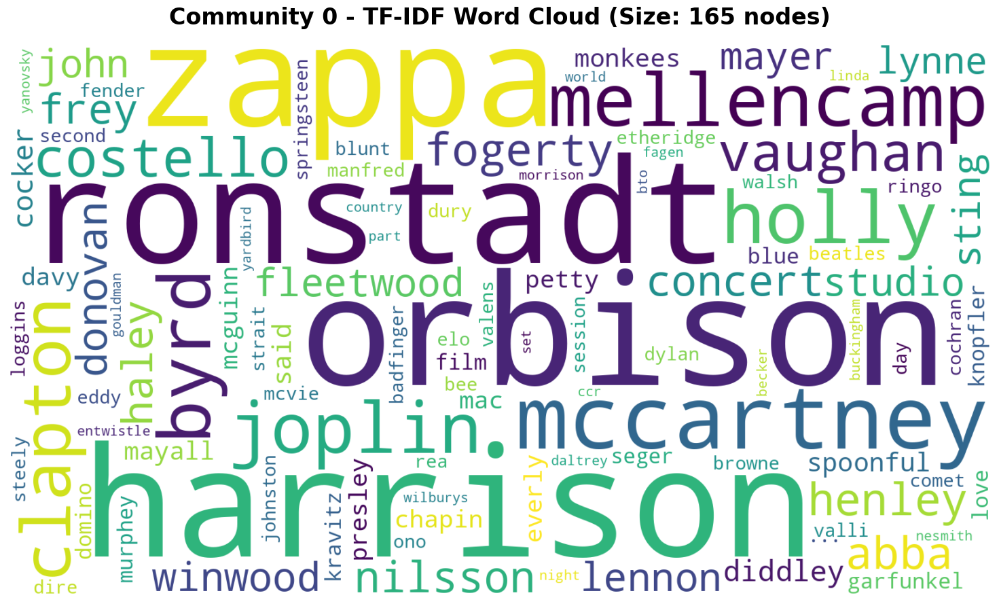

Saved: ../graphs/wordcloud_tfidf_community_1.png


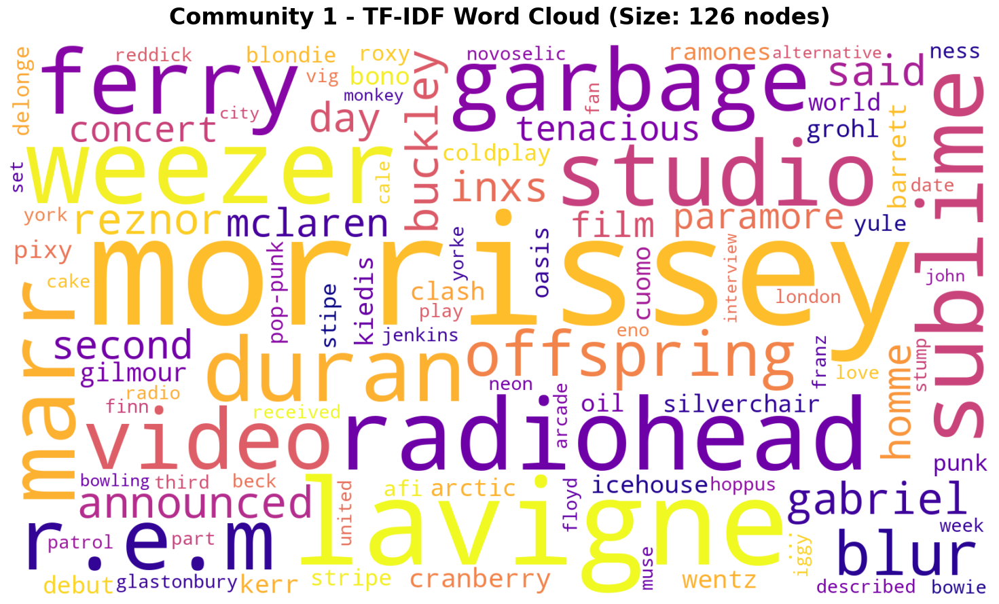

Saved: ../graphs/wordcloud_tfidf_community_2.png


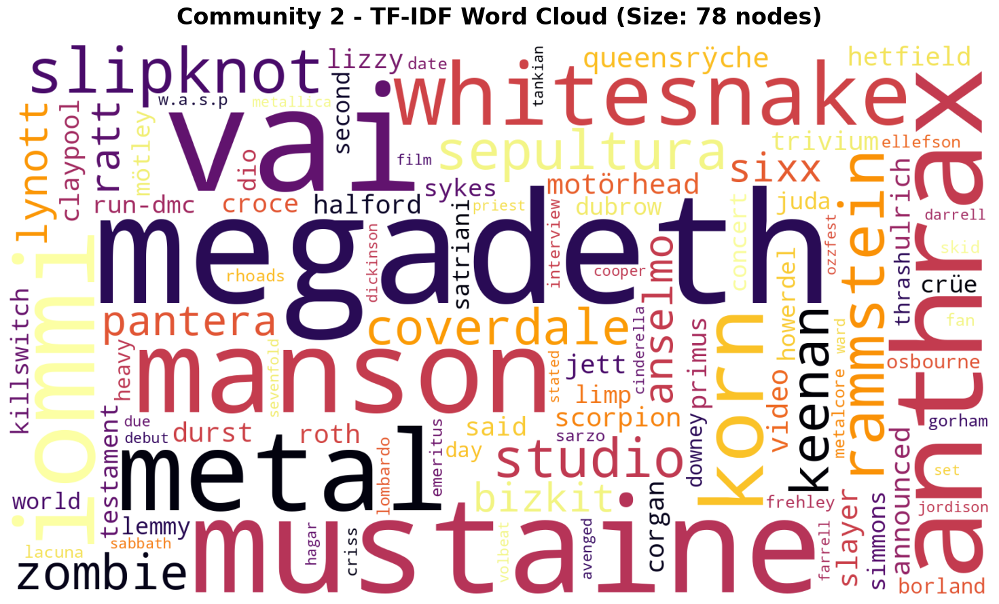

Saved: ../graphs/wordcloud_tfidf_community_3.png


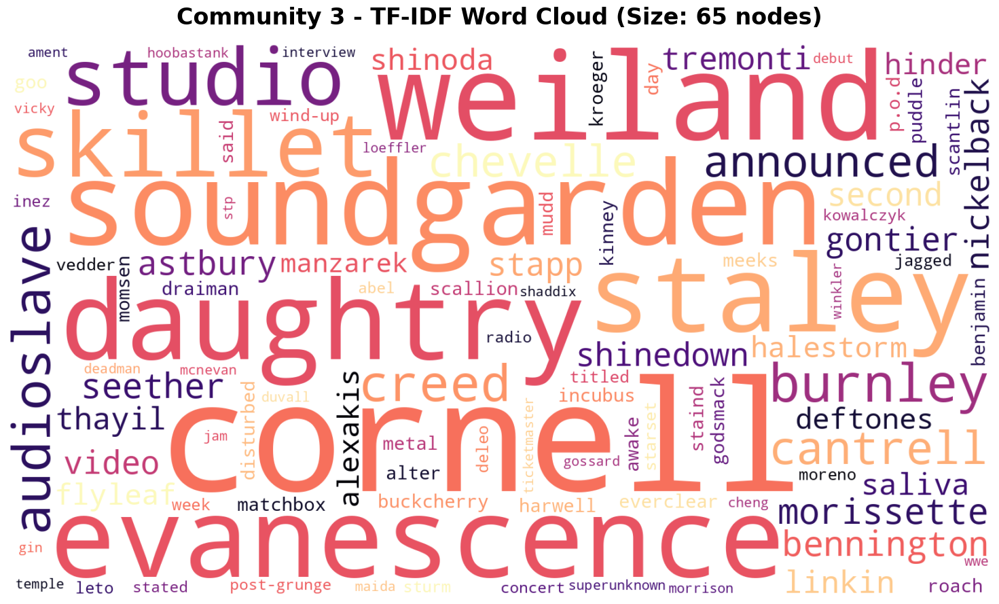

Saved: ../graphs/wordcloud_tfidf_community_4.png


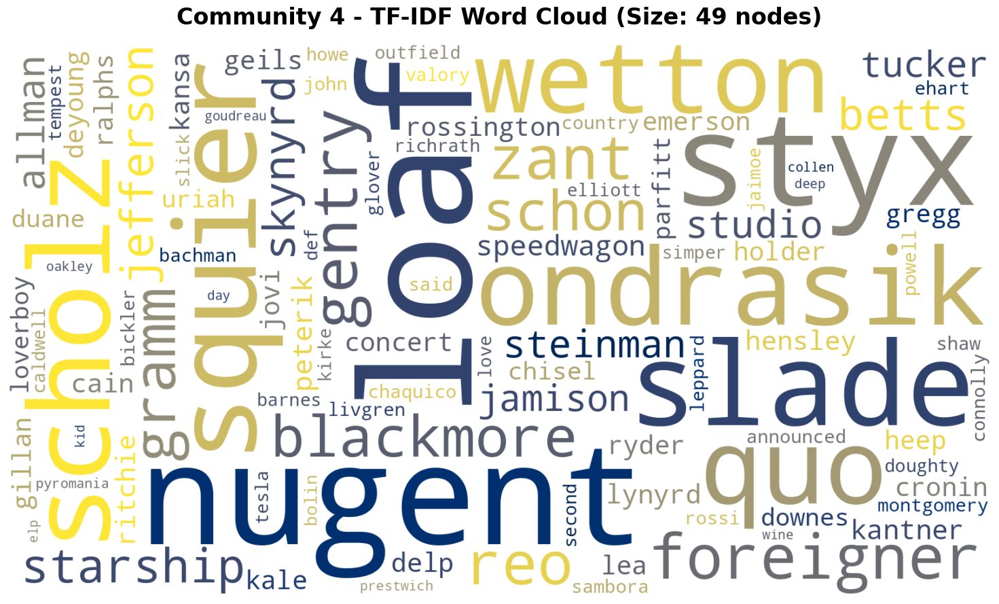

Saved: ../graphs/wordcloud_tfidf_community_5.png


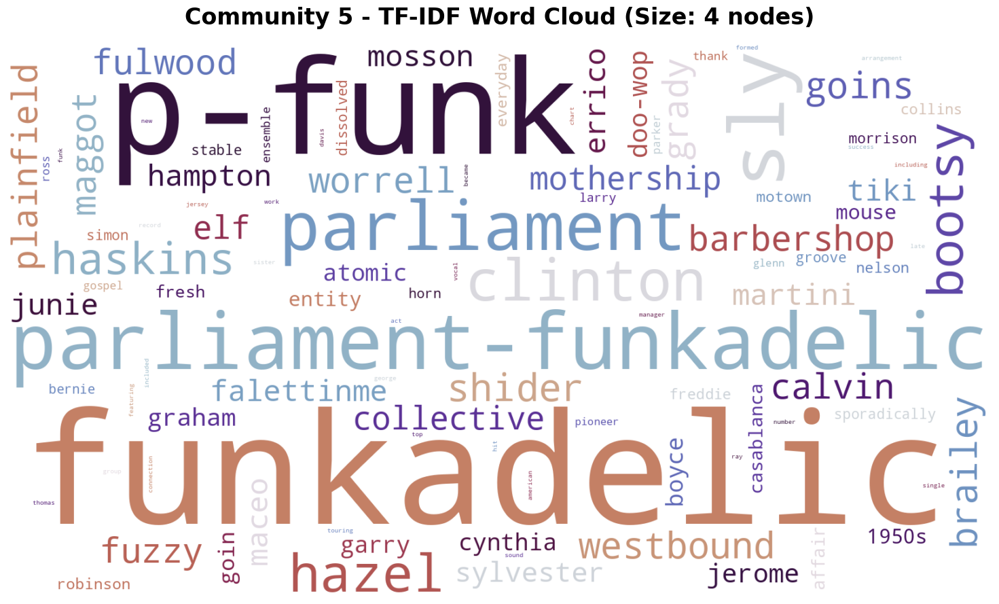


COMMUNITY WORD CLOUDS COMPLETE


In [58]:
# Step 1: Create TF lists for the 15 largest structural communities
print("="*80)
print("CREATING TF LISTS FOR STRUCTURAL COMMUNITIES")
print("="*80)

# Get the 15 largest communities from Louvain algorithm
top_15_communities_struct = sorted_communities[:15]

print(f"\nTop 15 community sizes:")
for i, comm in enumerate(top_15_communities_struct):
    print(f"Community {i}: {len(comm)} nodes")

# Create TF lists for each community
community_tf_lists = {}

# Check if we have cached results
if os.path.exists('../graphs/community_tf_lists.pkl'):
    print("\nLoading cached community TF lists...")
    with open('../graphs/community_tf_lists.pkl', 'rb') as f:
        community_tf_lists = pickle.load(f)
else:
    print("\nFetching Wikipedia pages for communities...")
    
    for comm_idx, community in enumerate(top_15_communities_struct):
        print(f"\nProcessing Community {comm_idx} ({len(community)} artists)...")
        
        # Aggregate all tokens for this community
        all_tokens = []
        
        for i, artist in enumerate(community):
            if i % 10 == 0:
                print(f"  Artist {i}/{len(community)}: {artist}")
            
            wiki_text = fetch_wikipedia_text(artist)
            if not wiki_text:
                continue
            
            tokens = clean_and_tokenize(wiki_text)
            all_tokens.extend(tokens)
            
            time.sleep(0.3)
        
        # Create TF list for this community
        word_counts = Counter(all_tokens)
        # Filter rare words (appearing less than 5 times)
        filtered_counts = {word: count for word, count in word_counts.items() 
                          if count >= 5}
        
        community_tf_lists[comm_idx] = filtered_counts
        print(f"Community {comm_idx}: {len(filtered_counts)} unique words (after filtering)")
    
    # Save to avoid re-scraping
    with open('../graphs/community_tf_lists.pkl', 'wb') as f:
        pickle.dump(community_tf_lists, f)

# Step 2: Calculate IDF for communities
print("\n" + "="*80)
print("CALCULATING TF-IDF FOR COMMUNITIES")
print("="*80)

# Collect all unique words across all communities
all_words_comm = set()
for comm_idx, tf_dict in community_tf_lists.items():
    all_words_comm.update(tf_dict.keys())

print(f"\nTotal unique words across all communities: {len(all_words_comm)}")

# Calculate IDF for each word
N_comm = len(top_15_communities_struct)
idf_comm = {}

for word in all_words_comm:
    # Count in how many communities this word appears
    nt = sum(1 for comm_idx in range(len(top_15_communities_struct)) 
             if comm_idx in community_tf_lists and word in community_tf_lists[comm_idx])
    # Calculate IDF using natural logarithm (base e)
    if nt > 0:
        idf_comm[word] = math.log(N_comm / nt)
    else:
        idf_comm[word] = 0

print(f"Calculated IDF for {len(idf_comm)} words")

# Step 3: Calculate TF-IDF for each community
community_tfidf = {}

for comm_idx in range(len(top_15_communities_struct)):
    if comm_idx not in community_tf_lists:
        continue
    
    tf_dict = community_tf_lists[comm_idx]
    tfidf_dict = {}
    
    for word, tf_count in tf_dict.items():
        tf = tf_count
        tfidf_dict[word] = tf * idf_comm[word]
    
    community_tfidf[comm_idx] = tfidf_dict

# Step 4: Display top 10 TF-IDF words for each community
print("\n" + "="*80)
print("TOP 10 WORDS BY TF-IDF FOR EACH COMMUNITY")
print("="*80)

for comm_idx in range(len(top_15_communities_struct)):
    if comm_idx not in community_tfidf:
        continue
    
    tfidf_dict = community_tfidf[comm_idx]
    top_10_tfidf = sorted(tfidf_dict.items(), key=lambda x: x[1], reverse=True)[:10]
    
    print(f"\nCOMMUNITY {comm_idx} (Size: {len(top_15_communities_struct[comm_idx])} nodes):")
    print("-" * 60)
    for word, score in top_10_tfidf:
        tf = community_tf_lists[comm_idx][word]
        print(f"  {word:20s} TF-IDF: {score:8.2f}  (TF: {tf:5d})")

# Step 5: Create TF-IDF word clouds for communities
print("\n" + "="*80)
print("CREATING TF-IDF WORD CLOUDS FOR COMMUNITIES")
print("="*80)

colormaps = ['viridis', 'plasma', 'inferno', 'magma', 'cividis', 
             'twilight', 'rainbow', 'jet', 'hot', 'cool',
             'spring', 'summer', 'autumn', 'winter', 'copper']

for comm_idx in range(len(top_15_communities_struct)):
    if comm_idx not in community_tfidf:
        continue
    
    tfidf_dict = community_tfidf[comm_idx]
    
    # Rescale TF-IDF scores
    rescaled_tfidf = rescale_tfidf_for_wordcloud(tfidf_dict)
    
    # Additional stopwords
    additional_stopwords = {
        'wikipedia', 'cite', 'web', 'retrieved', 'www', 'http', 
        'archive', 'original', 'archived', 'january', 'february',
        'march', 'april', 'may', 'june', 'july', 'august',
        'september', 'october', 'november', 'december', 'band',
        'album', 'song', 'released'
    }
    
    # Remove stopwords
    cleaned_tfidf = {word: score for word, score in rescaled_tfidf.items() 
                     if word not in additional_stopwords}
    
    # Create wordcloud
    cmap = colormaps[comm_idx % len(colormaps)]
    wordcloud = WordCloud(
        width=1600, 
        height=900,
        background_color='white',
        colormap=cmap,
        collocations=False,
        max_words=100,
        relative_scaling=0.5,
        min_font_size=10,
        max_font_size=250,
        prefer_horizontal=0.7,
        margin=10
    ).generate_from_frequencies(cleaned_tfidf)
    
    # Plot
    plt.figure(figsize=(16, 9))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Community {comm_idx} - TF-IDF Word Cloud (Size: {len(top_15_communities_struct[comm_idx])} nodes)', 
              fontsize=24, fontweight='bold', pad=20)
    plt.axis('off')
    plt.tight_layout()
    
    # Save
    filename = f'../graphs/wordcloud_tfidf_community_{comm_idx}.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight', facecolor='white')
    print(f"Saved: {filename}")
    
    plt.show()
    plt.close()

print("\n" + "="*80)
print("COMMUNITY WORD CLOUDS COMPLETE")
print("="*80)